In [3]:
from astropy.table import Table
from dendrocat import RadioSource
from astropy.io import fits
from spectral_cube import SpectralCube
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
import numpy as np
import sys
import importlib
from astropy.wcs import WCS
from scipy import interpolate
import pandas as pd
import sympy as syp
from astropy import units as u
import radio_beam
from astropy.table import Table
from radio_beam import Beam
from astropy import coordinates
from astropy import wcs
from astropy.nddata.utils import Cutout2D
from astropy.io import ascii
from matplotlib.patches import Rectangle, Ellipse, Circle
import Paths.Paths as paths

Path = paths.filepaths()

from matplotlib import colors
import astropy.units as u
import matplotlib as mpl
import seaborn as sns

plt.rcParams['axes.labelsize']=60
plt.rcParams['xtick.labelsize']=50
plt.rcParams['ytick.labelsize']=50
plt.rcParams['axes.titlesize']=60
mpl.rcParams['axes.linewidth'] = 5
mpl.rcParams['xtick.major.size'] = 10
mpl.rcParams['xtick.major.width'] = 2
mpl.rcParams['xtick.minor.size'] = 5
mpl.rcParams['xtick.minor.width'] = 1
mpl.rcParams['ytick.major.size'] = 10
mpl.rcParams['ytick.major.width'] = 2
mpl.rcParams['ytick.minor.size'] = 5
mpl.rcParams['ytick.minor.width'] = 1
class core_catdata():
    def __init__(self,catfile, almaimf_beam,  start_coreno, hrfits=None,band='B3', recommend_criteria = 'b6', include_ff='all' ):
        catdata_w51e = ascii.read(catfile,data_start=0,format='commented_header', header_start=120,  comment="!")
        geo_avg_beam = np.sqrt(almaimf_beam.major.to(u.arcsec).value*almaimf_beam.minor.to(u.arcsec).value)
        corr_factor = catdata_w51e['AFWHM02'] * catdata_w51e['BFWHM02'] / catdata_w51e['AFWHM03'] / catdata_w51e['BFWHM03']
        numcore_tot = len(catdata_w51e['AFWHM02'])
        if include_ff=='all':
            coreno_merged = start_coreno[0] + start_coreno[1]
            print('coreno_merged',coreno_merged)
            coreno_merged.sort()
            coreno_start = coreno_merged
            print('coreno_start',coreno_start)
        elif include_ff=='ffonly':
            coreno_start = start_coreno[1]
        elif include_ff=='no':
            coreno_start = start_coreno[0]
        coreidx_start = [i for i in range(numcore_tot) if catdata_w51e['NO'][i] in coreno_start]
        if recommend_criteria == 'b6b3':
            coreidx = [idx for idx in coreidx_start if all([np.abs(catdata_w51e['GOODM02'][idx])>1,  
                       np.abs(catdata_w51e['SIGNM02'][idx])>1,  
                       catdata_w51e['FXP_BST02'][idx]/catdata_w51e['FXP_ERR02'][idx]>2, 
                       catdata_w51e['FXT_BST02'][idx]/catdata_w51e['FXT_ERR02'][idx]>2, 
                       catdata_w51e['AFWHM02'][idx]/catdata_w51e['BFWHM02'][idx]<2 ,
                        catdata_w51e['FOOA02'][idx]/catdata_w51e['AFWHM02'][idx]>1.15 ,
                        np.sqrt(catdata_w51e['AFWHM03'][idx]*catdata_w51e['BFWHM03'][idx]) <4 * geo_avg_beam  ,
                        catdata_w51e['AFWHM03'][idx]/catdata_w51e['BFWHM03'][idx]<=2 ,
                        np.abs(catdata_w51e['SIGNM03'][idx])>1 ,
                        catdata_w51e['FXP_BST03'][idx]/catdata_w51e['FXP_ERR03'][idx]>1,  
                        catdata_w51e['FXT_BST03'][idx]/catdata_w51e['FXT_ERR03'][idx]>1])]
        elif recommend_criteria == 'b6':
            coreidx = coreidx_start                  
       
        
        if hrfits is not None:
            yso_image = fits.open(hrfits)[0].data[0][0]
            hrhdr = fits.open(hrfits)[0].header
            inside_idx = exist_inside_FOV(catdata_w51e['WCS_ACOOR'], catdata_w51e['WCS_DCOOR'], yso_image, hrhdr)
    
            rec_ind = np.intersect1d(coreidx, inside_idx)
        else:
            rec_ind = coreidx
        print('total core number = ', len(catdata_w51e['WCS_ACOOR']))
        print(hrfits)
        print('robust %s measurement before applying FoV criteria = '%band, len(coreidx))
        print('robust %s measurement after applying FoV criteria = '%band, len(rec_ind))
       
        self.sky_ra = catdata_w51e['WCS_ACOOR'][rec_ind]
        self.sky_dec = catdata_w51e['WCS_DCOOR'][rec_ind]
        self.pix_x = catdata_w51e['XCO_P'][rec_ind]
        self.pix_y = catdata_w51e['YCO_P'][rec_ind]
        
        if band=='B3':
            bandind = 3
        else:
            bandind = 2

        self.afwhm = catdata_w51e['AFWHM0%d'%bandind][rec_ind] #arcsec
        self.bfwhm = catdata_w51e['BFWHM0%d'%bandind][rec_ind]

        self.asize = catdata_w51e['ASIZE0%d'%bandind][rec_ind]
        self.bsize = catdata_w51e['BSIZE0%d'%bandind][rec_ind]

        self.theta = catdata_w51e['THETA0%d'%bandind][rec_ind]
        
        self.flux = catdata_w51e['FXT_BST0%d'%bandind][rec_ind]
        self.fluxerr = catdata_w51e['FXT_ERR0%d'%bandind][rec_ind]
        self.flux_g = catdata_w51e['FXT_ALT0%d'%bandind][rec_ind]

        self.fooa = catdata_w51e['FOOA0%d'%bandind][rec_ind]
        self.foob = catdata_w51e['FOOB0%d'%bandind][rec_ind]
        
        self.int_peak = catdata_w51e['FXP_BST0%d'%bandind][rec_ind]
        self.interr_peak = catdata_w51e['FXP_ERR0%d'%bandind][rec_ind]
        
        self.size = (catdata_w51e['AFWHM0%d'%bandind][rec_ind]*catdata_w51e['BFWHM0%d'%bandind][rec_ind]**2)**(1/3) #arcsec


        self.no = catdata_w51e['NO'][rec_ind]

        
        
        rescaled_3mmflux = catdata_w51e['FXT_BST03'][rec_ind] * catdata_w51e['AFWHM02'][rec_ind] * catdata_w51e['BFWHM02'][rec_ind] / catdata_w51e['AFWHM03'][rec_ind]/catdata_w51e['BFWHM03'][rec_ind]
        gamma = np.log10(catdata_w51e['FXT_BST02'][rec_ind] / rescaled_3mmflux)/np.log10(228.918/101.426)
        self.woffind = np.where(gamma>2)[0]
        self.wffind = np.where(gamma<2)[0]
        self.rec_ind = rec_ind

    def get_temperature(self,tempfile,temp100ind = [], temp300ind =[]):
        #temp100ind = hot cores with 100K
        #temp300ind = hot cores with 300K

        tab = ascii.read(tempfile, data_start=4)
        id = tab['col1']
        ra = tab['col2']
        dec = tab['col3']
        temp = tab['col4']

        """
        for i in range(len(self.sky_ra)):
            dist = np.sqrt((self.sky_ra[i]-ra)**2+(self.sky_dec[i]-dec)**2) #deg
            mindist = np.min(dist)
            if mindist<threshold:
                index = np.argmin(dist)
                temparr.append(temp[index])
            else:
                temparr.append(np.nan)
        """
        temparr = np.array([temp[np.where(id==no)[0]][0] for no in self.no])
        for i in range(len(temp100ind)):
            if temp100ind[i] in self.no:
                idx100 = np.where(self.no==temp100ind[i])[0]
                print(idx100)
                temparr[idx100] = 100
                print('#%d core temp -->100K'%temp100ind[i])
        for i in range(len(temp300ind)):
            if temp300ind[i] in self.no:
                idx300 = np.where(self.no==temp300ind[i])[0]
                temparr[idx300] = 300
                print('#%d core temp -->300K'%temp300ind[i])
        self.temp = np.array(temparr)*u.K
        
        return self.temp
    
    def get_tau(self, freq, omega):
        bb = models.BlackBody(temperature=self.temp)
    
        peak_int = (self.int_peak * u.Jy/u.beam).to(u.Jy/u.sr, equivalencies=u.beam_angular_area(omega))

        return -np.log(1 - (peak_int/ bb(freq).to(u.Jy/u.sr)).to(u.cm/u.cm).value)
    
    def get_coremass(self, freq, kappa, dist,omega):
            
        print('self.temp',self.temp)
        bb = models.BlackBody(temperature=self.temp)
        peak_int = (self.int_peak * u.Jy/u.beam).to(u.Jy/ u.sr, equivalencies=u.beam_angular_area(omega))
        print('peak_int',peak_int)
        print('self.flux',self.flux)
        print('kappa',kappa)
        print(bb(freq).to(u.Jy/u.sr))
        mass = - 1 / kappa * dist**2 * self.flux * u.Jy/ u.sr / peak_int * np.log(1 - (peak_int/ bb(freq).to(u.Jy/u.sr)).to(u.cm/u.cm).value)
        print((peak_int/ bb(freq).to(u.Jy/u.sr)).to(u.cm/u.cm).value)
        print(mass)
        print('mass',mass.to(u.Msun))
        self.mass = mass.to(u.Msun)
        return mass.to(u.Msun)
    
    def get_coremasserr(self):
        
        masserr = np.abs(self.mass * np.sqrt((self.fluxerr/self.flux)**2+(self.interr_peak/self.int_peak)**2))
        self.masserr = masserr
        return masserr.to(u.Msun)
                       
    def get_Jeansmass(self, dist=5400):
        rad = (self.afwhm.value*dist * self.bfwhm.value**2*dist**2)**(1/3) #arcsec -> au
        rho = self.mass / (4/3*np.pi * (rad*u.au)**3)
        c_s = np.sqrt(c.k_B*self.temp/2.8/c.m_p)
        jeans_mass = np.pi**(5/2)/6/c.G**(3/2) * c_s.to(u.cm/u.s)**3 * rho.to(u.g/u.cm**3)**(-1/2)
        
        return jeans_mass.to(u.Msun)

    def get_Jeansmasserr(self,dist=5400):
        rad = (self.afwhm.value*dist * self.bfwhm.value**2*dist**2)**(1/3) #arcsec -> au
        rho = self.mass / (4/3*np.pi * (rad*u.au)**3)
        c_s = np.sqrt(c.k_B*self.temp/2.8/c.m_p)
        jeans_mass = np.pi**(5/2)/6/c.G**(3/2) * c_s.to(u.cm/u.s)**3 * rho.to(u.g/u.cm**3)**(-1/2)
        rho_err = self.masserr / (4/3*np.pi * (rad*u.au)**3)

        jeans_mass_err = 0.5*jeans_mass * (rho_err/rho)

        return jeans_mass_err.to(u.Msun)
    def get_BE_mass(self, dist=5400):
        rad = (self.afwhm.value*dist * self.bfwhm.value**2*dist**2)**(1/3)
        rho = self.mass / (4/3*np.pi * (rad*u.au)**3)

        BE_mass = 1.18 * np.sqrt((c.k_B*self.temp/2.33/c.m_p/c.G)**3/rho).to(u.Msun)
        return BE_mass.to(u.Msun)
    
    def get_BE_masserr(self, dist=5400):
        rad = (self.afwhm.value*dist * self.bfwhm.value**2*dist**2)**(1/3)
        rho = self.mass / (4/3*np.pi * (rad*u.au)**3)

        BE_mass = 1.18 * np.sqrt((c.k_B*self.temp/2.33/c.m_p/c.G)**3/rho).to(u.Msun)
        rho_err = self.masserr / (4/3*np.pi * (rad*u.au)**3)

        BE_mass_err = 0.5*BE_mass * (rho_err/rho)
        return BE_mass_err.to(u.Msun)
    
    
    def multiplicity(self, hdrhr, xysource, almaimf_beam=None,issky=True, label=None, aperture='fwhm+beam',limitarea=None,  maxrad=1e3, verbose=False):
        ncat = len(self.no)
        if limitarea is not None:
            posind = np.where((sky_ra>limitarea[0])&(sky_ra<limitarea[1])&
                              (sky_dec>limitarea[2])&(sky_dec<limitarea[3]))[0]
        else:
            posind = np.arange(ncat)
        if label is None:
            label=np.arange(ncat)
        coreidx = np.arange(ncat)

        totalind = np.intersect1d(posind, label)
        print('totalind',totalind)
        sky_ra = self.sky_ra[totalind]
        sky_dec = self.sky_dec[totalind]
        fooa = self.fooa[totalind]
        foob = self.foob[totalind]
        theta = self.theta[totalind]
        no = self.no[totalind]
        afwhm =self.afwhm[totalind]
        bfwhm = self.bfwhm[totalind]

        skypos = np.vstack((sky_ra,sky_dec)).T


        wcshr = WCS(hdrhr,naxis=2)
        scalehr = wcshr.proj_plane_pixel_scales()[0]

        xypos_core = wcshr.wcs_world2pix(skypos,0)
        xpos_core = xypos_core[:,0]
        ypos_core = xypos_core[:,1]

        if issky:
            xysource_pix = wcshr.wcs_world2pix(xysource,0)
        else:
            xysource_pix = xysource
        ysonumarr=[] ; coreindarr=[]; ysoindarr=[]
        prestellar_ind = []
        protostellar_ind = []
        #print(xysource)
        for i in range(len(xypos_core)):
            if aperture is 'footprint':
                major = fooa[i]/3600/scalehr.value
                minor = foob[i]/3600/scalehr.value
                pa = theta[i]+90
            elif aperture is 'fwhm+beam':
                meanbeamsize = (almaimf_beam.major.value+almaimf_beam.minor.value)/4
                major = (afwhm[i]/3600+meanbeamsize)/scalehr.value
                minor = (bfwhm[i]/3600+meanbeamsize)/scalehr.value
                pa = theta[i]+90
            elif aperture is 'beam':
                major = almaimf_beam.major.value/scalehr.value
                minor = almaimf_beam.minor.value/scalehr.value
                pa = almaimf_beam.pa.value+90
            #if major > maxrad:
            #    continue

            numsource, indsource = count_points_in_ellipse(xpos_core[i],ypos_core[i],major,minor,pa,xysource_pix[:,0],xysource_pix[:,1])
            print(totalind[i], indsource, numsource)
            ysonumarr.append(numsource)
            coreindarr.append(totalind[i])
            ysoindarr.append(indsource)
            if numsource==0:
                prestellar_ind.append(totalind[i])
            elif numsource>0:
                protostellar_ind.append(totalind[i])
            
            
      
        ysoindarr_flat = []
        for arr in ysoindarr:
            ysoindarr_flat.extend(arr)
       
        print('cores with/without YSOs ', len(np.where(np.array(ysonumarr)!=0)[0]), len(xpos_core)-len(np.where(np.array(ysonumarr)!=0)[0]))
        print('YSOs associated with cores',len(np.unique(ysoindarr_flat)),' out of ',len(xysource_pix[:,0]))
              
        self.ysonumarr = ysonumarr
        self.coreindarr = coreindarr
        self.ysoindarr = ysoindarr
        self.prestellar_ind = prestellar_ind
        self.protostellar_ind = protostellar_ind
        print('pre,pro',self.prestellar_ind, self.protostellar_ind)
        return ysonumarr, coreindarr, ysoindarr, prestellar_ind, protostellar_ind
        


def count_points_in_ellipse(xcen,ycen,major,minor,pa,xpos,ypos):
    # caclulate foci positions 
    # must be full major, minor not semi major, minor
    fodx = np.cos(pa)*np.sqrt((major/2)**2-(minor/2)**2)
    fody = np.sin(pa)*np.sqrt((major/2)**2-(minor/2)**2)
    
    fox1 = xcen + fodx
    foy1 = ycen + fody
    
    fox2 = xcen - fodx
    foy2 = ycen - fody
    
    dist1 = np.sqrt((xpos-fox1)**2+(ypos-foy1)**2)
    dist2 = np.sqrt((xpos-fox2)**2+(ypos-foy2)**2)
    
    isinside = np.where(dist1+dist2<major)[0]
    
    return len(isinside), list(isinside)

def exist_inside_FOV(xcore_sky, ycore_sky, yso_image, hrhdr):
    isfinite = np.where(np.isfinite(yso_image))
    xfinite1 = np.min(isfinite[0])
    xfinite2 = np.max(isfinite[0])
    yfinite1 = np.min(isfinite[1])
    yfinite2 = np.max(isfinite[1])
     
    xcen = (xfinite1 + xfinite2)/2
    ycen = (yfinite1 + yfinite2)/2

    wcs_hr = WCS(hrhdr,naxis=2)
    xypos = wcs_hr.wcs_world2pix(np.vstack((xcore_sky,ycore_sky)).T,0)
    
    rad = np.abs(xfinite2 - xcen)
    
    
    dist = np.sqrt((xypos[:,0]- xcen)**2+(xypos[:,1]-ycen)**2)
    isinside = np.where(dist<rad)[0]
    
    return isinside
def plot_catalog_on_image(ax, hdr_image,  catdatadir, idx_start, isb3=False,beam=None,
                         color='cyan',lw=4,aperture='fwhm+beam',xysource=None,ls='solid',fontsize=30
                          ):
    catdata = ascii.read(catdatadir,data_start=0,format='commented_header', header_start=120,  comment="!")
    idx = [i for i in range(len(catdata['NO'])) if catdata['NO'][i] in idx_start]
    sky_ra = catdata['WCS_ACOOR'][idx]
    sky_dec = catdata['WCS_DCOOR'][idx]
    no = catdata['NO'][idx]
    if isb3:
        bandlabel = '03'
    else:
        bandlabel = '02'
    fooa = catdata['FOOA%s'%bandlabel][idx]
    foob = catdata['FOOB%s'%bandlabel][idx]
    theta = catdata['THETA%s'%bandlabel][idx]
    afwhm = catdata['AFWHM%s'%bandlabel][idx]
    bfwhm = catdata['BFWHM%s'%bandlabel][idx]
   
    
    skypos = np.vstack((sky_ra,sky_dec)).T

    
    wcsNB = WCS(hdr_image,naxis=2)

    xypos = wcsNB.wcs_world2pix(skypos,0)
    xpos = xypos[:,0]
    ypos = xypos[:,1]
    
    pixel_scale = wcsNB.proj_plane_pixel_scales()[0]
        
    indexlist = []
    for i in range(len(xypos)):
        if aperture is 'footprint':
            major = fooa[i]/3600/pixel_scale.value
            minor = foob[i]/3600/pixel_scale.value
            pa = theta[i]
        elif aperture is 'fwhm+beam':
            meanbeamsize = (beam.major.value+beam.minor.value)/4
            major = (afwhm[i]/3600+meanbeamsize)/pixel_scale.value
            minor = (bfwhm[i]/3600+meanbeamsize)/pixel_scale.value
            pa = theta[i]
        elif aperture is 'beam':
            major = beam.major.value/pixel_scale.value
            minor = beam.minor.value/pixel_scale.value
            pa = beam.pa.value
    
        ellipse = Ellipse(xypos[i],width=major,height=minor,facecolor='none',
                        angle=pa+90,edgecolor=color,lw=lw,ls=ls)
        
        ax.add_patch(ellipse)
        if xysource is not None:
            numsource, indsource = count_points_in_ellipse(xpos[i],ypos[i],major,minor,pa+90,xysource[:,0],xysource[:,1])
            

            ax.text(xpos[i]+50,ypos[i]+70,'%d'%numsource,color='w',fontsize=fontsize,clip_on=True)
            indexlist.append(indsource)
    if xysource is not None:
        return indexlist
    

        
def plot_dendrogram(ax, catalog, what_to_draw, extent=[],downarrow=[], bbox=None,
    wcsNB=None,legend=True, size=80,color='cyan', facecolor='none', 
    band='b6',lw=2,fill=False,xsort=True, fontsize=20, xtextoffset=0,ytextoffset=0, offset_default=20,
    arrow_text_xoffset=0, arrow_text_yoffset=0, arrow_yoffset=50, fontcolor='w', arrow_angle=None, arrow_length=None, anno_font_color='w', xycoords_manual=None, issky=False):
    
    if band=='b6':
        otherband='b3'
    elif band=='b3':
        otherband='b6'
    xsky = catalog['%s_xsky'%band]
    ysky = catalog['%s_ysky'%band]
    xysky = np.vstack((xsky, ysky)).T
    xypos = wcsNB.wcs_world2pix(xysky,0)
    
    xpos = xypos[:,0]
    ypos = xypos[:,1]
    
    xsky_otherband = catalog['%s_xsky'%otherband]
    ysky_otherband = catalog['%s_ysky'%otherband]
    xysky_otherband = np.vstack((xsky_otherband, ysky_otherband)).T
    xypos_otherband = wcsNB.wcs_world2pix(xysky_otherband,0)
    xpos_otherband = xypos_otherband[:,0]
    ypos_otherband = xypos_otherband[:,1]
    
    x_both = np.array([xpos[i] if xsky[i]>0 else xpos_otherband[i] for i in range(len(xpos))])
    y_both = np.array([ypos[i] if xsky[i]>0 else ypos_otherband[i] for i in range(len(xpos))])

    no = np.arange(len(catalog))

    #alpha = catalog['alpha']
    group = catalog['group']
    if xycoords_manual is not None:
        x_both = xycoords_manual[:,0]
        y_both = xycoords_manual[:,1]
        if issky:
            xycoords_manual_pix = wcsNB.wcs_world2pix(xycoords_manual,0)
            xycoords_manual = xycoords_manual_pix
            x_both = xycoords_manual[:,0]
            y_both = xycoords_manual[:,1]
    print('len(catalog), len(x_both)',len(catalog), len(x_both))


    if arrow_angle is not None:
    
        arrow_text_xoffset = arrow_length * np.cos(np.deg2rad(arrow_angle))
        arrow_text_yoffset = arrow_length * np.sin(np.deg2rad(arrow_angle))

    print('arrow_text_xoffset',arrow_text_xoffset)
    print('arrow_text_yoffset',arrow_text_yoffset)
    if len(extent)>0:
        insideind = np.where((x_both>extent[0])&(x_both<extent[1])&(y_both>extent[2])&(y_both<extent[3]))[0]
        
        x_both = x_both[insideind]
        y_both = y_both[insideind]
        no = no[insideind]
        xsky = xsky[insideind]
        ysky = ysky[insideind]
        xsky_otherband = xsky_otherband[insideind]
        ysky_otherband = ysky_otherband[insideind]
        #alpha = alpha[insideind]
        group = group[insideind]
        if arrow_angle is not None:
            arrow_angle = arrow_angle[insideind]
            arrow_text_xoffset = arrow_text_xoffset[insideind]
            arrow_text_yoffset = arrow_text_yoffset[insideind]
    
    if xsort:
        sortind = np.argsort(x_both)
    else:
        sortind = np.argsort(y_both)
    print('len(sortind), len(x_both)',len(sortind), len(x_both))    
    
    x_both = x_both[sortind]
    y_both = y_both[sortind]
    no = no[sortind]
    xsky = xsky[sortind]
    ysky = ysky[sortind]
    xsky_otherband = xsky_otherband[sortind]
    ysky_otherband = ysky_otherband[sortind]
    #alpha = alpha[sortind]
    group = group[sortind]
    if arrow_angle is not None:

        arrow_text_xoffset = arrow_text_xoffset[sortind]
        arrow_text_yoffset = arrow_text_yoffset[sortind]
        arrow_angle = arrow_angle[sortind]

    if bbox is not None:
        x_both = x_both - bbox[0]
        y_both = y_both - bbox[1]

    
    print('arrow_text_xoffset2',arrow_text_xoffset)
    print('arrow_text_yoffset2',arrow_text_yoffset)

  
 
    for i in range(len(x_both)):
     
        if xsky[i]<0: #b3only
            color='magenta'
            
        elif xsky_otherband[i]<0: #b6only
            color='yellow'
           
        elif group[i]==2:
            color='springgreen'
        elif group[i]==1:
            color='orange'
    
        else:
            color='cyan'
        if i in downarrow:
            arrow_yoffset_used = -arrow_yoffset
        else:
            arrow_yoffset_used = arrow_yoffset
        if 'arrow' in what_to_draw:  
          
            arrow_xoffset_default = offset_default * np.cos(np.deg2rad(arrow_angle[i]))
            arrow_yoffset_default = offset_default * np.sin(np.deg2rad(arrow_angle[i]))
            ax.annotate("%d"%no[i],xy=(x_both[i]+arrow_xoffset_default,y_both[i]+arrow_yoffset_default), xycoords='data', textcoords='offset points',
                        arrowprops=dict(width=2, headwidth=6,ec=color,fc=color, frac=0.07),xytext=(arrow_text_xoffset[i]+arrow_xoffset_default, arrow_text_yoffset[i]+arrow_yoffset_default),fontsize=20,
                        color=anno_font_color, va='center', ha='center')

        if 'circle' in what_to_draw:
            circle = Circle((x_both[i],y_both[i]),radius=size, color=color,facecolor='none',lw=lw,fill=fill)
            ax.add_patch(circle)
            arrow_xoffset_default = offset_default * np.cos(np.deg2rad(arrow_angle[i]))
            arrow_yoffset_default = offset_default * np.sin(np.deg2rad(arrow_angle[i]))
            ax.annotate("%d"%no[i],xy=(x_both[i]+arrow_xoffset_default,y_both[i]+arrow_yoffset_default), xycoords='data', textcoords='offset points',
                        arrowprops=dict(width=2, headwidth=6,ec=color,fc=color, frac=0.07),xytext=(arrow_text_xoffset[i]+arrow_xoffset_default, arrow_text_yoffset[i]+arrow_yoffset_default),fontsize=25,
                        color=anno_font_color, va='center', ha='center')

        if 'cross' in what_to_draw:
            ax.scatter(x_both[i],y_both[i],s=size, marker='x',color='cyan', edgecolor='k')
        if 'scatter' in what_to_draw:
            arrow_xoffset_default = offset_default * np.cos(np.deg2rad(arrow_angle[i]))
            arrow_yoffset_default = offset_default * np.sin(np.deg2rad(arrow_angle[i]))
            ax.scatter(x_both[i],y_both[i],s=size, marker='o',color=color, edgecolor='k')
            ax.annotate("%d"%no[i],xy=(x_both[i]+arrow_xoffset_default,y_both[i]+arrow_yoffset_default), xycoords='data', textcoords='offset points',
                        arrowprops=dict(width=2, headwidth=4,ec=color,fc=color, ),xytext=(arrow_text_xoffset[i]+arrow_xoffset_default, arrow_text_yoffset[i]+arrow_yoffset_default),fontsize=30,
                        color=anno_font_color, va='center', ha='center')
            print('arrow_text_xoffset3',arrow_text_xoffset[i], arrow_text_yoffset[i]+arrow_yoffset_used)
        if 'text' in what_to_draw:
            ax.text(x_both[i]+xtextoffset,y_both[i]+ytextoffset, '%d'%no[i], color=color, fontsize=fontsize,
                    clip_on=True)
                        
def add_scale_bar(ax, xpos,ypos,scale, pixel_scale, dist,height=20,color='w',pad=40,size=40,xoffset=0, forceint=False):
    scale_at_dist = (scale/dist).to(u.au/u.au)*u.rad 
    scaled_scale = (scale_at_dist / pixel_scale).to(u.rad/u.rad) #units of pixel
    print(pixel_scale)
    print(scale_at_dist)
    print(scaled_scale)
    xl = xpos - scaled_scale.value/2
    
    ax.add_patch(Rectangle((xpos,ypos),scaled_scale.value,height,color=color))
    if forceint:
        if scale.unit.is_equivalent(u.pc):
            unit = 'pc'
        elif scale.unit.is_equivalent(u.au):
            unit = 'au'
        ax.text(xpos+(0.4+xoffset)*scaled_scale, ypos+pad, "%i %s"%(scale.value, unit), color=color,fontsize=size,
        ha='center', va='center')
    else:
        ax.text(xpos+(0.4+xoffset)*scaled_scale, ypos+pad, f"{scale}", color=color,fontsize=size, ha='center', va='center')
    
   

def add_beam(ax,xpos,ypos,beam, pixel_scale,color='w',square=False,square_size=800):
    width = beam.major / pixel_scale
    height = beam.minor /pixel_scale
    angle = beam.pa
    ax.add_patch(Ellipse((xpos,ypos),width.value,height.value,angle.value+90,color=color))
    if square:
        ax.scatter(xpos,ypos,facecolor='none', edgecolor=color,s=square_size,marker='s')



def draw_field_of_view(ax, image_highres, wcs_highres, wcs_lowres, color='r', lw=2, ls='dotted'):
    center = int(image_highres.shape[0]/2)
    index = np.where(np.isnan(image_highres[center,:])==False)[0]
    sky0 = wcs_highres.pixel_to_world(center, np.min(index))
    sky1 = wcs_highres.pixel_to_world(center, np.max(index))
    pix0_in_lowres = wcs_lowres.world_to_pixel(sky0)
    pix1_in_lowres = wcs_lowres.world_to_pixel(sky1)

    circle= Circle(( 
    pix0_in_lowres[0], (pix0_in_lowres[1].item()+pix1_in_lowres[1].item())/2),
    radius=(pix1_in_lowres[1].item()-pix0_in_lowres[1].item())/2, color=color,fill=False, lw=lw, ls=ls)
    ax.add_patch(circle)


In [4]:
from astropy.coordinates import SkyCoord
fitsdata_highres_w51e_b3 = fits.open(Path.w51e_b3_tt0)
image_highres_w51e_b3 = fitsdata_highres_w51e_b3[0].data[0][0]
hdr_highres_w51e_b3 = fits.getheader(Path.w51e_b3_tt0)
wcs_highres_w51e_b3 = WCS(hdr_highres_w51e_b3,naxis=2)
beam_highres_w51e_b3 = Beam.from_fits_header(hdr_highres_w51e_b3)
scale_highres_w51e_b3 = wcs_highres_w51e_b3.proj_plane_pixel_scales()[0]

fitsdata_highres_w51e_b6 = fits.open(Path.w51e_b6_tt0)
image_highres_w51e_b6 = fitsdata_highres_w51e_b6[0].data[0][0]
hdr_highres_w51e_b6 = fits.getheader(Path.w51e_b6_tt0)
wcs_highres_w51e_b6 = WCS(hdr_highres_w51e_b6,naxis=2)
beam_highres_w51e_b6 = Beam.from_fits_header(hdr_highres_w51e_b6)
scale_highres_w51e_b6 = wcs_highres_w51e_b6.proj_plane_pixel_scales()[0]

hdr_highres_w51n_b3 = fits.getheader(Path.w51n_b3_tt0)
wcs_highres_w51n_b3 = WCS(hdr_highres_w51n_b3,naxis=2)
fitsdata_highres_w51n_b3 = fits.open(Path.w51n_b3_tt0)
image_highres_w51n_b3 = fitsdata_highres_w51n_b3[0].data[0][0]
beam_highres_w51n_b3 = Beam.from_fits_header(hdr_highres_w51n_b3)
scale_highres_w51n_b3 = wcs_highres_w51n_b3.proj_plane_pixel_scales()[0]

fitsdata_highres_w51n_b6 = fits.open(Path.w51n_b6_tt0)
image_highres_w51n_b6 = fitsdata_highres_w51n_b6[0].data[0][0]
hdr_highres_w51n_b6 = fits.getheader(Path.w51n_b6_tt0)
wcs_highres_w51n_b6 = WCS(hdr_highres_w51n_b6,naxis=2)
beam_highres_w51n_b6 = Beam.from_fits_header(hdr_highres_w51n_b6)



catalog_w51e_yso = Table.read(Path.w51e_dendro_matched_catalog_new,format='fits')
catalog_w51n_yso = Table.read(Path.w51n_dendro_matched_catalog_new,format='fits')

#isincore_w51e_b3 = catalog_w51e_yso['inincore_b3fov'] 
#isincore_w51n_b3 = catalog_w51n_yso['inincore_b3fov'] 
#isoutcore_w51e_b3 = np.where(~catalog_w51e_yso['inincore_b3fov'])[0] 
##isoutcore_w51n_b3 = np.where(~catalog_w51n_yso['inincore_b3fov'])[0] 


# For b6, need to combine isincore index with isoverlap index
#isincore_w51e_b6 = np.intersect1d(np.where(catalog_w51e_yso['inincore_b3fov']), np.where(catalog_w51e_yso['is_overlap'])) 
#isincore_w51n_b6 = np.intersect1d(np.where(catalog_w51n_yso['inincore_b3fov']), np.where(catalog_w51n_yso['is_overlap'])) 
#isoutcore_w51e_b6 = np.intersect1d(np.where(~catalog_w51e_yso['inincore_b3fov']), np.where(catalog_w51e_yso['is_overlap'])) 
#isoutcore_w51n_b6 = np.intersect1d(np.where(~catalog_w51n_yso['inincore_b3fov']), np.where(catalog_w51n_yso['is_overlap'])) 

iscore_ff_w51e = [41, 46, 48, 50, 51, 54, 56, 8, 9, 10, 85, 119, 25]
iscore_ff_w51n = [61, 3, 6, 7, 23, 29, 70, 71, 72, 52]
"""
print(isoutcore_w51e_b3)
print('isincore_w51e_b6',isincore_w51e_b6)
print('isincore_w51n_b6',isincore_w51n_b6)
print('isoutcore_w51e_b6',isoutcore_w51e_b6)
print('isoutcore_w51n_b6',isoutcore_w51n_b6)
isoutcore_w51e_b3 = [i for i in list(isoutcore_w51e_b3) if i not in iscore_ff_w51e]
isoutcore_w51n_b3 = [i for i in list(isoutcore_w51n_b3) if i not in iscore_ff_w51n]
isoutcore_w51e_b6 = [i for i in list(isoutcore_w51e_b6) if i not in iscore_ff_w51e]
isoutcore_w51n_b6 = [i for i in list(isoutcore_w51n_b6) if i not in iscore_ff_w51n]
"""
si_w51e = catalog_w51e_yso['alpha']
si_w51n = catalog_w51n_yso['alpha']

hdrB6_w51e_almaimf = fits.getheader(Path.w51e_b6_almaimf)  
wcsB6_w51e_almaimf = WCS(hdrB6_w51e_almaimf,naxis=2)
beamb6_w51e_almaimf = Beam.from_fits_header(hdrB6_w51e_almaimf)  

hdrB3_w51e_almaimf = fits.getheader(Path.w51e_b3_almaimf)  
wcsB3_w51e_almaimf = WCS(hdrB3_w51e_almaimf,naxis=2)
beamb3_w51e_almaimf = Beam.from_fits_header(hdrB3_w51e_almaimf) 
scale_w51e_b3_almaimf = wcsB3_w51e_almaimf.proj_plane_pixel_scales()[0] 

hdrB6_w51n_almaimf = fits.getheader(Path.w51n_b6_almaimf)  
wcsB6_w51n_almaimf = WCS(hdrB6_w51n_almaimf,naxis=2)
beamb6_w51n_almaimf = Beam.from_fits_header(hdrB6_w51n_almaimf)  

hdrB3_w51n_almaimf = fits.getheader(Path.w51n_b3_almaimf)  
wcsB3_w51n_almaimf = WCS(hdrB3_w51n_almaimf,naxis=2)
beamb3_w51n_almaimf = Beam.from_fits_header(hdrB3_w51n_almaimf)  
coreidx_w51e_fabien = [[2,4,8,11,12,13,14,15,16,17,19,21,22,26,28,29,33,34,38,39],[1,3,5,6,9,10,18,27]] #30, 31, 20 are discarded because they have duplicated pairs in IRS2
coreidx_w51n_fabien = [[1,2,4,6,7,8,9,10,11,12,13,14,15,16,17,19,20,22,23,24,25,26,27,28,29,31,32,33,34,35,37,38,40,41,42,43,44,45,46,47,48,
49,51,52,53,54,55,57,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,84,85,86,87,88,89,90,91,92,94,95,97,99,100,101,102,104,105,106,107,108,109,111,114,117,119,122,123],
[3,5,18,36,56,58,98,113,118,124]]

core_catdata_w51e_b6_b6crit_b3fov = core_catdata(Path.w51e_almaimf_catalog,beamb3_w51e_almaimf,  coreidx_w51e_fabien, hrfits=Path.w51e_b3_tt0, band='B6',)
core_catdata_w51n_b6_b6crit_b3fov = core_catdata(Path.w51n_almaimf_catalog,beamb3_w51n_almaimf,  coreidx_w51n_fabien, hrfits=Path.w51n_b3_tt0, band='B6',)

core_catdata_w51e_b6_b6crit_b3fov_ff = core_catdata(Path.w51e_almaimf_catalog,beamb3_w51e_almaimf,  coreidx_w51e_fabien, hrfits=Path.w51e_b3_tt0, band='B6',include_ff='ffonly')
core_catdata_w51n_b6_b6crit_b3fov_ff = core_catdata(Path.w51n_almaimf_catalog,beamb3_w51n_almaimf,  coreidx_w51n_fabien, hrfits=Path.w51n_b3_tt0, band='B6',include_ff='ffonly')


hdrhr_w51e_b3 = hdr_highres_w51e_b3
hdrhr_w51n_b3 = hdr_highres_w51n_b3

catalog_w51e_yso = Table.read(Path.w51e_dendro_matched_catalog_new ,format='fits')
print(catalog_w51e_yso)


yso_w51e_xsky_b6 = catalog_w51e_yso['b6_xsky'] ; yso_w51e_ysky_b6 = catalog_w51e_yso['b6_ysky']
yso_w51e_xsky_b3 = catalog_w51e_yso['b3_xsky'] ; yso_w51e_ysky_b3 = catalog_w51e_yso['b3_ysky']

yso_detect_w51e_b6 = np.where(yso_w51e_xsky_b6>0)[0]
yso_detect_w51e_b3 = np.where(yso_w51e_xsky_b3>0)[0]


catalog_w51n_yso = Table.read(Path.w51n_dendro_matched_catalog_new ,format='fits')
yso_w51n_xsky_b6 = catalog_w51n_yso['b6_xsky'] ; yso_w51n_ysky_b6 = catalog_w51n_yso['b6_ysky']
yso_w51n_xsky_b3 = catalog_w51n_yso['b3_xsky'] ; yso_w51n_ysky_b3 = catalog_w51n_yso['b3_ysky']


yso_xsky_w51e = []
for i,x in enumerate(yso_w51e_xsky_b6):
    if x > 0:
        yso_xsky_w51e.append(x)
    else:
        yso_xsky_w51e.append(yso_w51e_xsky_b3[i])
yso_ysky_w51e = []
for i,x in enumerate(yso_w51e_ysky_b6):
    if x > 0:
        yso_ysky_w51e.append(x)
    else:
        yso_ysky_w51e.append(yso_w51e_ysky_b3[i])

yso_xsky_w51n = []
for i,x in enumerate(yso_w51n_xsky_b6):
    if x > 0:
        yso_xsky_w51n.append(x)
    else:
        yso_xsky_w51n.append(yso_w51n_xsky_b3[i])
yso_ysky_w51n = []
for i,x in enumerate(yso_w51n_ysky_b6):
    if x > 0:
        yso_ysky_w51n.append(x)
    else:
        yso_ysky_w51n.append(yso_w51n_ysky_b3[i])

yso_xysource_w51e= np.vstack((yso_xsky_w51e, yso_ysky_w51e)).T
yso_xysource_w51n= np.vstack((yso_xsky_w51n, yso_ysky_w51n)).T

yso_xysource_pix_w51e = wcs_highres_w51e_b3.wcs_world2pix(yso_xysource_w51e,0)
yso_xysource_pix_w51n = wcs_highres_w51n_b3.wcs_world2pix(yso_xysource_w51n,0)

yso_skycoord_w51e = SkyCoord(ra=yso_xsky_w51e, dec=yso_ysky_w51e, unit=(u.deg, u.deg), frame='icrs')
yso_skycoord_w51n = SkyCoord(ra=yso_xsky_w51n, dec=yso_ysky_w51n, unit=(u.deg, u.deg), frame='icrs')

multiplicity_w51e_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.multiplicity(hdrhr_w51e_b3,yso_xysource_w51e,
                                 almaimf_beam = beamb6_w51e_almaimf)

multiplicity_w51n_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.multiplicity(hdrhr_w51n_b3,yso_xysource_w51n,
                                 almaimf_beam = beamb6_w51n_almaimf,)

prestellar_w51e_b6crit_b3fov = multiplicity_w51e_b6crit_b3fov[3]
prestellar_w51n_b6crit_b3fov = multiplicity_w51n_b6crit_b3fov[3]
protostellar_w51e_b6crit_b3fov = multiplicity_w51e_b6crit_b3fov[4]
protostellar_w51n_b6crit_b3fov = multiplicity_w51n_b6crit_b3fov[4]


skypos_w51e_b6_b6crit_b3fov_prestellar = np.vstack((core_catdata_w51e_b6_b6crit_b3fov.sky_ra[prestellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.sky_dec[prestellar_w51e_b6crit_b3fov])).T



coreno_merged [2, 4, 8, 11, 12, 13, 14, 15, 16, 17, 19, 21, 22, 26, 28, 29, 33, 34, 38, 39, 1, 3, 5, 6, 9, 10, 18, 27]
coreno_start [1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 21, 22, 26, 27, 28, 29, 33, 34, 38, 39]
total core number =  41
/orange/adamginsburg/w51/TaehwaYoo/2017.1.00293.S_W51_B3_LB/may2021_successful_imaging/w51e2.spw0thru19.14500.robust0.thr0.075mJy.mfs.I.startmod.selfcal7.image.tt0.pbcor.fits
robust B6 measurement before applying FoV criteria =  28
robust B6 measurement after applying FoV criteria =  26
coreno_merged [1, 2, 4, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 22, 23, 24, 25, 26, 27, 28, 29, 31, 32, 33, 34, 35, 37, 38, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 51, 52, 53, 54, 55, 57, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 84, 85, 86, 87, 88, 89, 90, 91, 92, 94, 95, 97, 99, 100, 101, 102, 104, 105, 106, 107, 108, 109, 111, 114, 117, 119, 122, 123, 3, 5, 18, 36, 56, 58, 98, 113, 1

In [5]:
from regions import Regions
def plot_cores(ax, skypos, afwhm, bfwhm, theta, hdrhr, beam_almaimf,color='cyan', lw=2, label=None,fontsize=40,ls='solid'):
    wcsNB = WCS(hdrhr,naxis=2)
    scalehr = wcsNB.proj_plane_pixel_scales()[0]
    xypos = wcsNB.wcs_world2pix(skypos,0)

    for i in range(len(xypos)):
        meanbeamsize = (beam_almaimf.major.value+beam_almaimf.minor.value)/4
        major = (afwhm[i]/3600+meanbeamsize)/scalehr.value
        minor = (bfwhm[i]/3600+meanbeamsize)/scalehr.value
        pa = 90+theta[i]
        ellipse = Ellipse(xypos[i],width=major,height=minor,facecolor='none',
                          angle=180-pa,edgecolor=color,lw=lw) 
        ax.add_patch(ellipse)
        if label is not None:
            if isinstance(label[i],u.Quantity):
                ax.text(xypos[i][0],xypos[i][1],'%3.2f'%label[i].value,color=color,fontsize=8,ls=ls) 
            else:
                ax.text(xypos[i][0],xypos[i][1],label[i],color=color,fontsize=fontsize,ls=ls)
def plot_regions(ax, region_read, wcshr, labelon=True,lw=3):
    
    labels = [chr(65 + i) for i in range(len(regions_read))]
    for region, label in zip(regions_read, labels):
        pix_reg = region.to_pixel(wcshr)
        pix_reg.plot(ax=ax1, color='orange', lw=lw)
        
        if labelon:
            center = pix_reg.bounding_box.center
            white_square = Rectangle((center[1]-100, center[0]-100), 200, 200, color='white', lw=3)
            ax.add_patch(white_square)
            ax.text(center[1], center[0], label, color='k', fontsize=30, ha='center', va='center')

no_w51e_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.no[multiplicity_w51e_b6crit_b3fov[1]]
no_w51n_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.no[multiplicity_w51n_b6crit_b3fov[1]]
"""
fig = plt.figure(figsize=(30,30))
ax1 = fig.add_axes([0.3,0.3,0.7,0.7],projection=wcs_highres_w51e_b3)
ax1.imshow(image_highres_w51e_b3, origin='lower',cmap=plt.get_cmap('gray'),
           vmin=-0.00010907209521789237,vmax=0.0008191315689840496)
draw_field_of_view(ax1,image_highres_w51e_b6 , wcs_highres_w51e_b6, wcs_highres_w51e_b3 , color='r', lw=4, ls='dotted') 

#plot_cores(ax1, skypos_w51e_b6_b6crit_b3fov_prestellar, core_catdata_w51e_b6_b6crit_b3fov.afwhm[prestellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.bfwhm[prestellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.theta[prestellar_w51e_b6crit_b3fov], 
#           hdrhr_w51e_b3, beamb6_w51e_almaimf, color='cyan', lw=2, label=no_w51e_b6crit_b3fov[prestellar_w51e_b6crit_b3fov])
plot_cores(ax1, skypos_w51e_b6_b6crit_b3fov_prestellar, core_catdata_w51e_b6_b6crit_b3fov.afwhm[prestellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.bfwhm[prestellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.theta[prestellar_w51e_b6crit_b3fov], 
           hdrhr_w51e_b3, beamb6_w51e_almaimf, color='w', lw=2, ls='dashed')
skypos_w51e_b6_b6crit_b3fov_protostellar = np.vstack((core_catdata_w51e_b6_b6crit_b3fov.sky_ra[protostellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.sky_dec[protostellar_w51e_b6crit_b3fov])).T
plot_cores(ax1, skypos_w51e_b6_b6crit_b3fov_protostellar, core_catdata_w51e_b6_b6crit_b3fov.afwhm[protostellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.bfwhm[protostellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.theta[protostellar_w51e_b6crit_b3fov], 
           hdrhr_w51e_b3, beamb6_w51e_almaimf, color='cyan', lw=2, ls='dashed' )

skypos_w51e_b6_b6crit_b3fov_wff= np.vstack((core_catdata_w51e_b6_b6crit_b3fov_ff.sky_ra, core_catdata_w51e_b6_b6crit_b3fov_ff.sky_dec)).T
plot_cores(ax1, skypos_w51e_b6_b6crit_b3fov_wff, core_catdata_w51e_b6_b6crit_b3fov_ff.afwhm, core_catdata_w51e_b6_b6crit_b3fov_ff.bfwhm, core_catdata_w51e_b6_b6crit_b3fov_ff.theta, 
           hdrhr_w51e_b3, beamb6_w51e_almaimf, color='lime', lw=2, ls='dashed' )


plot_dendrogram(ax1, catalog_w51e_yso, 'scatter', wcsNB=wcs_highres_w51e_b3,band='b3',size=80,color=si_w51e, facecolor=si_w51e)
ax1.set_ylim(1350,11500)
ax1.set_xlim(5500,13000)
ax1.set_xlabel('RA (ICRS)')
ax1.set_ylabel('DEC (ICRS)')
#ax, xpos,ypos,scale, pixel_scale, dist,
add_scale_bar(ax1, 7000, 2000,  0.1*u.pc,
                 
                  scale_highres_w51e_b3, 5.4 * u.kpc, size=30, pad=180,xoffset=0.1)
colors=sns.color_palette("tab10")
regions_read = Regions.read('/orange/adamginsburg/w51/TaehwaYoo/regions/w51e_for_overview_plot.reg', format='ds9')


plot_regions(ax1, regions_read, wcs_highres_w51e_b3)

plt.savefig('ppo_map_si_w51e_largest.png')
"""

'\nfig = plt.figure(figsize=(30,30))\nax1 = fig.add_axes([0.3,0.3,0.7,0.7],projection=wcs_highres_w51e_b3)\nax1.imshow(image_highres_w51e_b3, origin=\'lower\',cmap=plt.get_cmap(\'gray\'),\n           vmin=-0.00010907209521789237,vmax=0.0008191315689840496)\ndraw_field_of_view(ax1,image_highres_w51e_b6 , wcs_highres_w51e_b6, wcs_highres_w51e_b3 , color=\'r\', lw=4, ls=\'dotted\') \n\n#plot_cores(ax1, skypos_w51e_b6_b6crit_b3fov_prestellar, core_catdata_w51e_b6_b6crit_b3fov.afwhm[prestellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.bfwhm[prestellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.theta[prestellar_w51e_b6crit_b3fov], \n#           hdrhr_w51e_b3, beamb6_w51e_almaimf, color=\'cyan\', lw=2, label=no_w51e_b6crit_b3fov[prestellar_w51e_b6crit_b3fov])\nplot_cores(ax1, skypos_w51e_b6_b6crit_b3fov_prestellar, core_catdata_w51e_b6_b6crit_b3fov.afwhm[prestellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.bfwhm[prestellar_w51e_b6crit_b3fov], core_catdata_w5

A
RegionBoundingBox(ixmin=9143, ixmax=9715, iymin=10286, iymax=10858)
(array([124]),)
B
RegionBoundingBox(ixmin=8000, ixmax=8572, iymin=9714, iymax=10287)
(array([123]),)
C
RegionBoundingBox(ixmin=8571, ixmax=9144, iymin=9714, iymax=10287)
(array([121]),)
D
RegionBoundingBox(ixmin=10286, ixmax=10858, iymin=9714, iymax=10287)
(array([122]),)
E
RegionBoundingBox(ixmin=8000, ixmax=8572, iymin=9143, iymax=9715)
(array([66]),)
F
RegionBoundingBox(ixmin=8571, ixmax=9144, iymin=9143, iymax=9715)
(array([ 64,  65,  67,  68, 119, 120]),)
G
RegionBoundingBox(ixmin=7429, ixmax=8001, iymin=8571, iymax=9144)
(array([ 62,  63, 113]),)
H
RegionBoundingBox(ixmin=6857, ixmax=7430, iymin=8000, iymax=8572)
(array([59]),)
I
RegionBoundingBox(ixmin=7429, ixmax=8001, iymin=8000, iymax=8572)
(array([61]),)
J
RegionBoundingBox(ixmin=8000, ixmax=8572, iymin=8000, iymax=8572)
(array([83]),)
K
RegionBoundingBox(ixmin=8571, ixmax=9144, iymin=8000, iymax=8572)
(array([60]),)
L
RegionBoundingBox(ixmin=6857, ixmax=7

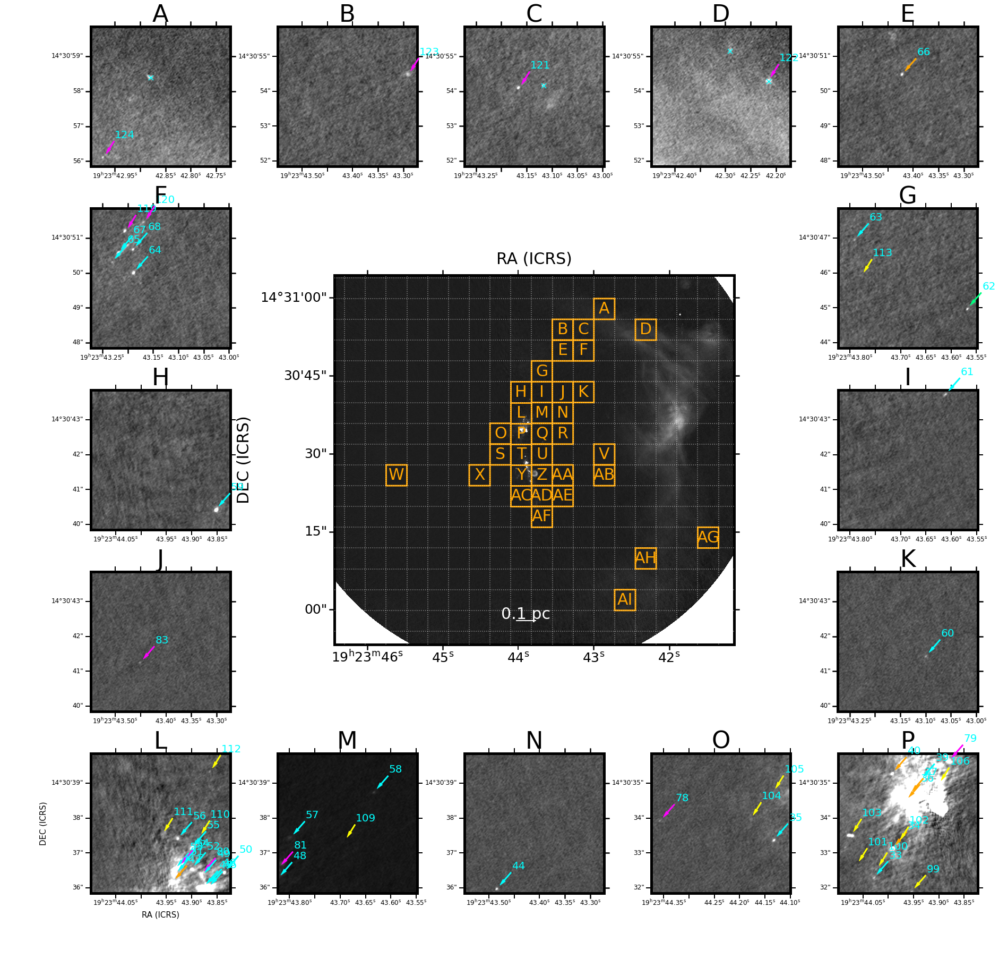

In [7]:
from astropy.wcs.utils import proj_plane_pixel_scales
from astropy.visualization.wcsaxes import WCSAxes
import matplotlib.pyplot as plt
import numpy as np
from astropy import units as u
from regions import PixCoord
from regions import RectangleSkyRegion, RectanglePixelRegion
from matplotlib.gridspec import GridSpec

# Assuming `wcs_highres_w51e_b3` is your WCS object and `image_highres_w51e_b3` is your image data
fig = plt.figure(figsize=(30, 30))

gs = GridSpec(5,7,wspace=0.3, hspace=0.3, width_ratios=[1,0.3,0.7,1,0.7,0.3,1])
ax_main = fig.add_subplot(gs[1:-1, 2:-2], projection=wcs_highres_w51e_b3)

# Display the image
ax_main.imshow(image_highres_w51e_b3, origin='lower', cmap='gray', 
          vmin=-0.00010907209521789237, vmax=0.0008191315689840496)

# Add grid with 5 arcsecond intervals
pixel_scale = proj_plane_pixel_scales(wcs_highres_w51e_b3)[0]  # Pixel scale in degrees/pixel
arcsec_per_pixel = pixel_scale * 3600  # Convert to arcseconds/pixel
grid_interval_pixels = 4 / arcsec_per_pixel  # Convert 4 arcseconds to pixels

# Generate grid lines
image_height, image_width = image_highres_w51e_b3.shape
x_coords = np.arange(0, image_width, grid_interval_pixels)
y_coords = np.arange(0, image_height, grid_interval_pixels)

xcen = (x_coords[:-1] + x_coords[1:]) / 2
ycen = (y_coords[:-1] + y_coords[1:]) / 2

cenxy = np.vstack((xcen, ycen)).T
cenxy_sky = wcs_highres_w51e_b3.wcs_pix2world(cenxy,0)
regions_grid = []
for y_sky in cenxy_sky[::-1, 1]:
    for x_sky in cenxy_sky[:, 0]:
        # Create a rectangle region for each grid point
        # Note: Adjust the width and height as needed
        regions_grid.append(RectangleSkyRegion(center=SkyCoord(ra=x_sky, dec=y_sky, unit=(u.deg, u.deg)),
                                    width=4*u.arcsec, height=4*u.arcsec,
                                    ))

labels = [chr(65 + i) for i in range(26)]
labels += [chr(65 + i) + chr(65 + j) for i in range(26) for j in range(26)]

reg_selected = []
count=0
for i, reg in enumerate(regions_grid):
    if any(reg.contains(yso_skycoord_w51e, wcs_highres_w51e_b3)):
        reg_pix = reg.to_pixel(wcs_highres_w51e_b3)
        reg_pix.plot(ax=ax_main, color='orange', lw=3)
        reg_selected.append(reg)

        print(labels[count])
        print(reg_pix.bounding_box)
        print(np.where(reg.contains(yso_skycoord_w51e, wcs_highres_w51e_b3)))
        count=count+1


# add alphabet labels. Alphabetical order. once all the alpha is used then it start from AA

for i, reg in enumerate(reg_selected):
    pix_reg = reg.to_pixel(wcs_highres_w51e_b3)
    center = pix_reg.bounding_box.center
  
    ax_main.text(center[1], center[0], labels[i], color='orange', fontsize=30, ha='center', va='center')




# Plot grid lines
for x in x_coords:
    ax_main.axvline(x=x, color='white', linestyle='dotted', alpha=0.5)
for y in y_coords:
    ax_main.axhline(y=y, color='white', linestyle='dotted', alpha=0.5)

# Add labels
ax_main.set_xlabel('RA (ICRS)', fontsize=30)
ax_main.set_ylabel('DEC (ICRS)', fontsize=30)
ax_main.coords[0].set_axislabel_position('t')
ax_main.coords[0].set_ticklabel(fontsize=25)
ax_main.coords[1].set_ticklabel(fontsize=25)
ax_main.set_ylim(1350,11500)
ax_main.set_xlim(2000,13000)
add_scale_bar(ax_main, 7000, 2000,  0.1*u.pc,
                 
                  scale_highres_w51e_b3, 5.4 * u.kpc, size=30, pad=180,xoffset=0.1)
def plot_subregion(fig, gs, image, xycoords_w51e, xycoords_w51n, catalog_w51e_yso, catalog_w51n_yso, wcs, wcs_other, reg1,  ax_xind, ax_yind, label, arrow_angle, arrow_length,scattersize=80,circlesize=20, color='cyan', facecolor='cyan', no_label=True, anno_font_color='w', isrelative_scaling=False, faintvmax=True,):
    import matplotlib.colors as colors
    reg1_pix = reg1.to_pixel(wcs)
    reg1_mask = reg1_pix.to_mask()

    if ax_yind==0:
        ax = fig.add_subplot(gs[ax_xind, 0], projection=wcs)
    elif ax_yind==1: 
        ax = fig.add_subplot(gs[ax_xind, 1:3], projection=wcs)
    elif ax_yind==2: 
        ax = fig.add_subplot(gs[ax_xind, 3], projection=wcs)
    elif ax_yind==3:
        ax = fig.add_subplot(gs[ax_xind, 4:6], projection=wcs)
    elif ax_yind==4:
        ax = fig.add_subplot(gs[ax_xind, 6], projection=wcs)
  
    
    ax.set_xlim(reg1_mask.bbox.ixmin, reg1_mask.bbox.ixmax)
    ax.set_ylim(reg1_mask.bbox.iymin, reg1_mask.bbox.iymax)
    if isrelative_scaling:
        vmin = np.nanmin(reg1_mask.cutout(image))
        vmax = 1.5*np.nanmax(reg1_mask.cutout(image))
        #vmin = np.percentile(reg1_mask.cutout(image), 5)
        #vmax = np.percentile(reg1_mask.cutout(image), 95)
        ax.imshow(reg1_mask.cutout(image), origin='lower',cmap=plt.get_cmap('gray'),
            vmin=vmin,vmax=vmax, extent=reg1_mask.bbox.extent)
    else:
        vmin = -0.0001066949037273116
        if faintvmax:
            vmax = 0.0002290923849534617
        else:
            vmax = 0.001092545412989736
    #ax.imshow(reg1_mask.cutout(image), origin='lower',cmap=plt.get_cmap('gray'),
    #        norm=colors.PowerNorm(gamma=0.5, vmin=vmin,vmax=vmax), extent=reg1_mask.bbox.extent)
    ax.imshow(reg1_mask.cutout(image), origin='lower',cmap=plt.get_cmap('gray'),
             vmin=vmin,vmax=vmax, extent=reg1_mask.bbox.extent)
    xycoords_w51n_sky = wcs_other.wcs_pix2world(xycoords_w51n,0)
    plot_dendrogram(ax, catalog_w51e_yso, 'arrow', wcsNB=wcs,band='b6',size=circlesize,color=color, facecolor=facecolor, extent=reg1_mask.bbox.extent, arrow_angle=arrow_angle, arrow_length=arrow_length, anno_font_color=anno_font_color, xycoords_manual=xycoords_w51e)
    plot_dendrogram(ax, catalog_w51n_yso, 'cross', wcsNB=wcs,band='b6',size=scattersize,color='cyan', facecolor='cyan',  extent=reg1_mask.bbox.extent, xycoords_manual=xycoords_w51n_sky, issky=True)

    ax.set_title(label, fontsize=45)
    ax.coords[0].set_ticklabel(exclude_overlapping=True)
    ax.coords[1].set_ticklabel(exclude_overlapping=True)
    ax.coords[0].set_ticklabel(size=12)
    ax.coords[1].set_ticklabel(size=12)

    #ax.coords[0].set_ticklabel_visible(False)
    #ax.coords[1].set_ticklabel_visible(False)    
    if no_label:
        ax.coords[0].set_axislabel(' ')
        ax.coords[1].set_axislabel(' ')
    else:
        ax.coords[0].set_axislabel('RA (ICRS)', fontsize=15)
        ax.coords[1].set_axislabel('DEC (ICRS)', fontsize=15)
   

num_yso = len(catalog_w51e_yso)

arrow_angle = np.ones(num_yso)*45
arrow_length = 30 * np.ones(num_yso)
    
ax_yinds = [0,1,2,3,4,0,4,0,4,0,4,0,1,2,3,4]
ax_xinds = [0,0,0,0,0,1,1,2,2,3,3,4,4,4,4,4]
reg_ind = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
"""
arrow_angle[118] = -135 # group B
arrow_angle[124] = -20 ; arrow_angle[125]=0 # group C
arrow_angle[126] = 180 # group D
arrow_angle[114] =0 ; arrow_angle[83]=0 # group N
arrow_angle[120]= -120
arrow_angle[127]=0
arrow_angle[69]=230
arrow_angle[67]=180 
arrow_angle[68]=-90
arrow_angle[70]=-40 ; arrow_angle[71]=-90 ; arrow_angle[73]=120 ; arrow_angle[74]=0 ; arrow_angle[123]=0 ; arrow_angle[130]=0
arrow_angle[115]=-180 ; arrow_angle[113]=140 ; arrow_angle[65] = 120 ; arrow_angle[54]=180; arrow_angle[112]=90 ; arrow_angle[57]=175; arrow_angle[56]=90 ; #group M
arrow_angle[61]= 160; arrow_angle[62]=150; arrow_angle[63]=140 ; arrow_angle[50]=0; arrow_angle[52]=180; arrow_angle[64]=100; arrow_angle[53]=150 # group M 
arrow_angle[60]=65 ; arrow_angle[59]=70 ; arrow_angle[64]=105; arrow_angle[56]=55; arrow_angle[58]=70 #group M

arrow_angle[40] =-90 # group P

arrow_length[61]= 70 ; arrow_length[62]=70; arrow_length[63]=70 ; arrow_length[54]=70; arrow_length[52]=20; arrow_length[60]=50; arrow_length[57]=80 
arrow_length[50]=10 ; arrow_length[112]=70; arrow_length[60]=60 ; arrow_length[59]=20 ; arrow_length[53]=20; arrow_length[58]=20; arrow_length[56]=20 # group M
"""
for i, reg in enumerate(reg_selected[:16]):
    if i==11:
        no_label = False
    else:
        no_label = True

    if i==12:
        faintvmax = False
    else:
        faintvmax = True
    plot_subregion(fig, gs, image_highres_w51e_b3, yso_xysource_pix_w51e, yso_xysource_pix_w51n, catalog_w51e_yso, catalog_w51n_yso, wcs_highres_w51e_b3, wcs_highres_w51n_b3, reg,  ax_xinds[i], ax_yinds[i], labels[i], arrow_angle, arrow_length, scattersize=80, color=si_w51e, facecolor=si_w51e, anno_font_color='cyan', no_label=no_label, faintvmax=faintvmax, )
    


# Save the plot
plt.savefig('ppo_map_w51e.png',bbox_inches='tight', pad_inches=0.0)
plt.show()

len(catalog), len(x_both) 132 132
arrow_text_xoffset [ 1.50000000e+01  2.12132034e+01  1.50000000e+01  3.00000000e+01
  3.07818129e+01  2.12132034e+01  3.00000000e+01 -3.00000000e+01
  2.12132034e+01  2.95442326e+01  1.83697020e-15  2.89777748e+01
  2.81907786e+01 -3.00000000e+01 -2.29813333e+01  2.12132034e+01
  1.83697020e-15  1.83697020e-15 -1.71010072e+01 -5.90884652e+01
  1.22464680e-15 -2.59807621e+01  1.83697020e-15 -1.50000000e+01
 -1.50000000e+01  1.41421356e+01  2.12132034e+01 -5.00000000e+00
  1.41421356e+01  1.76776695e+01 -7.76457135e+00 -7.66044443e+00
  2.12132034e+01 -3.00000000e+01 -2.95442326e+01 -2.81907786e+01
  2.12132034e+01  2.12132034e+01 -3.00000000e+01  1.83697020e-15
  1.83697020e-15  2.12132034e+01 -3.00000000e+01  8.66025404e+00
  1.83697020e-15  6.12323400e-16 -3.00000000e+01  2.81907786e+01
  2.95442326e+01 -1.50000000e+01  1.00000000e+01  2.12132034e+01
 -2.00000000e+01 -1.73205081e+01 -7.00000000e+01  2.12132034e+01
  1.14715287e+01 -7.96955758e+01  6.8

len(catalog), len(x_both) 132 132
arrow_text_xoffset [ 1.50000000e+01  2.12132034e+01  1.50000000e+01  3.00000000e+01
  3.07818129e+01  2.12132034e+01  3.00000000e+01 -3.00000000e+01
  2.12132034e+01  2.95442326e+01  1.83697020e-15  2.89777748e+01
  2.81907786e+01 -3.00000000e+01 -2.29813333e+01  2.12132034e+01
  1.83697020e-15  1.83697020e-15 -1.71010072e+01 -5.90884652e+01
  1.22464680e-15 -2.59807621e+01  1.83697020e-15 -1.50000000e+01
 -1.50000000e+01  1.41421356e+01  2.12132034e+01 -5.00000000e+00
  1.41421356e+01  1.76776695e+01 -7.76457135e+00 -7.66044443e+00
  2.12132034e+01 -3.00000000e+01 -2.95442326e+01 -2.81907786e+01
  2.12132034e+01  2.12132034e+01 -3.00000000e+01  1.83697020e-15
  1.83697020e-15  2.12132034e+01 -3.00000000e+01  8.66025404e+00
  1.83697020e-15  6.12323400e-16 -3.00000000e+01  2.81907786e+01
  2.95442326e+01 -1.50000000e+01  1.00000000e+01  2.12132034e+01
 -2.00000000e+01 -1.73205081e+01 -7.00000000e+01  2.12132034e+01
  1.14715287e+01 -7.96955758e+01  6.8

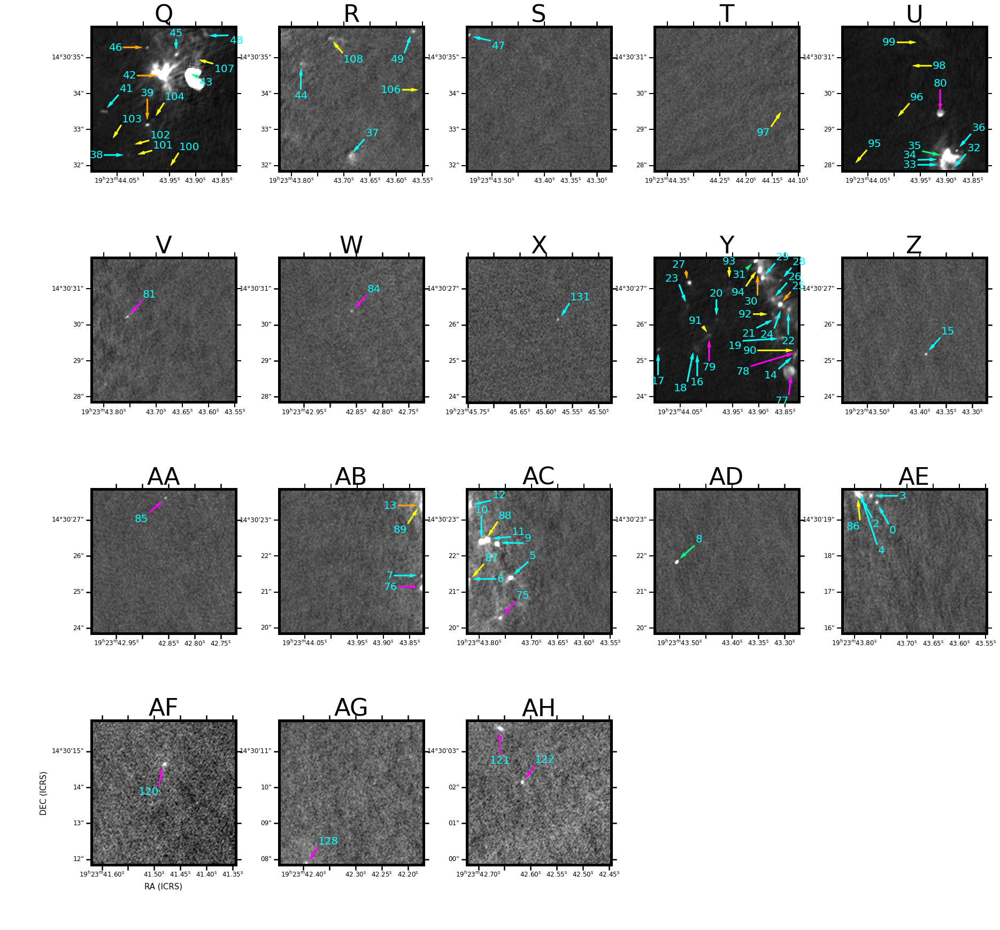

In [ ]:
fig = plt.figure(figsize=(30, 30))

gs = GridSpec(4,5,wspace=0.3, hspace=0.3)

ax_yinds = [0,1,2,3,4,0,1,2,3,4,0,1,2,3,4,0,1,2,3,4]
ax_xinds = [0,0,0,0,0,1,1,1,1,1,2,2,2,2,2,3,3,3,3,3]
reg_ind = np.arange(17)+16
arrow_angle[78] =170
arrow_angle[90] =180
arrow_angle[46] =180 ; arrow_angle[43]=0 ; arrow_angle[45]=90; arrow_angle[42]=180; arrow_angle[43]=-30 ; arrow_angle[107]=-20; arrow_angle[48]=-10; arrow_angle[38]=180;arrow_angle[101]=20; arrow_angle[102]=20; arrow_angle[39]=90 # group Q
arrow_angle[108]=-40; arrow_angle[49]=-120 ; arrow_angle[44]=-90 ; arrow_angle[106]=180#group R
arrow_angle[47]=-20 #group S
arrow_angle[97]=-130 #group T
arrow_angle[98]=0; arrow_angle[79]=-90;arrow_angle[80]=90; arrow_angle[33]=180; arrow_angle[34]=170; arrow_angle[35]=160; arrow_angle[99]=180

arrow_angle[20]=90; arrow_angle[16]=-90 ;arrow_angle[18]=-110; arrow_angle[93]=90; arrow_angle[31]=-140; arrow_angle[94]=230; arrow_angle[30]=-105 ; arrow_angle[77]=200; arrow_angle[14]=200; arrow_angle[19]=180; arrow_angle[22]=-90; arrow_angle[24]=-120#group X
arrow_angle[71]=0 ; arrow_angle[92]=180; arrow_angle[21]=-150; arrow_angle[91]=135 ; arrow_angle[17]=-90; arrow_angle[23]=120; arrow_angle[27]=120
arrow_angle[85] = -140
arrow_angle[10]=90; 
arrow_angle[12]=20; arrow_angle[9]=0; arrow_angle[6]=0; arrow_angle[11]=15; arrow_angle[9]=10; arrow_angle[88]=90
arrow_angle[0]=-60; arrow_angle[3]=0; arrow_angle[2]=-60; arrow_angle[86]=-100
arrow_angle[121]=-90;arrow_angle[88]=50
arrow_angle[4]=-70
arrow_angle[7]=180; arrow_angle[13]=180; arrow_angle[76]=180; arrow_angle[89]=230; arrow_angle[78]=-160; arrow_angle[19]=-170 ; arrow_angle[14]=-140 ; arrow_angle[77]=-110

arrow_length[18]=50
arrow_length[93]=10; arrow_length[28]=20; arrow_length[20]=20; arrow_length[71]=20; arrow_length[29]=25; arrow_length[25]=20; arrow_length[45]=10; arrow_length[43]=10; arrow_length[92]=20; arrow_length[31]=10; arrow_length[91]=10; arrow_length[27]=10
arrow_length[19]=60; arrow_length[90]=60 ; arrow_length[78]=80 ; arrow_length[4]=90
for i, reg in enumerate(reg_selected[16:]):
    if i==15:
        no_label = False
    else:
        no_label = True
    if i==0 or i==4 or i==8:
        faintvmax = False
    else:
        faintvmax = True
    plot_subregion(fig, gs, image_highres_w51e_b3, yso_xysource_pix_w51e, yso_xysource_pix_w51n,catalog_w51e_yso, catalog_w51n_yso, wcs_highres_w51e_b3, 
    wcs_highres_w51n_b3, reg,  ax_xinds[i], ax_yinds[i], labels[i+16], arrow_angle, arrow_length, scattersize=80, color=si_w51e, facecolor=si_w51e, 
    anno_font_color='cyan', no_label=no_label, faintvmax=faintvmax)

plt.savefig('ppo_map_w51e2.png',bbox_inches='tight', pad_inches=0.0)

A
RegionBoundingBox(ixmin=7429, ixmax=8001, iymin=10857, iymax=11430)
(array([70]),)
B
RegionBoundingBox(ixmin=8000, ixmax=8572, iymin=10857, iymax=11430)
(array([68, 69]),)
C
RegionBoundingBox(ixmin=1715, ixmax=2287, iymin=8000, iymax=8573)
(array([67]),)
D
RegionBoundingBox(ixmin=2857, ixmax=3430, iymin=8000, iymax=8573)
(array([65]),)
E
RegionBoundingBox(ixmin=10286, ixmax=10858, iymin=8000, iymax=8572)
(array([66]),)
F
RegionBoundingBox(ixmin=5143, ixmax=5715, iymin=7429, iymax=8001)
(array([27]),)
G
RegionBoundingBox(ixmin=5714, ixmax=6287, iymin=7429, iymax=8001)
(array([26]),)
H
RegionBoundingBox(ixmin=9714, ixmax=10287, iymin=7429, iymax=8001)
(array([25]),)
I
RegionBoundingBox(ixmin=10857, ixmax=11430, iymin=7429, iymax=8001)
(array([64]),)
J
RegionBoundingBox(ixmin=1715, ixmax=2287, iymin=6857, iymax=7430)
(array([62]),)
K
RegionBoundingBox(ixmin=6286, ixmax=6858, iymin=6857, iymax=7430)
(array([28]),)
L
RegionBoundingBox(ixmin=6857, ixmax=7430, iymin=6857, iymax=7430)
(array

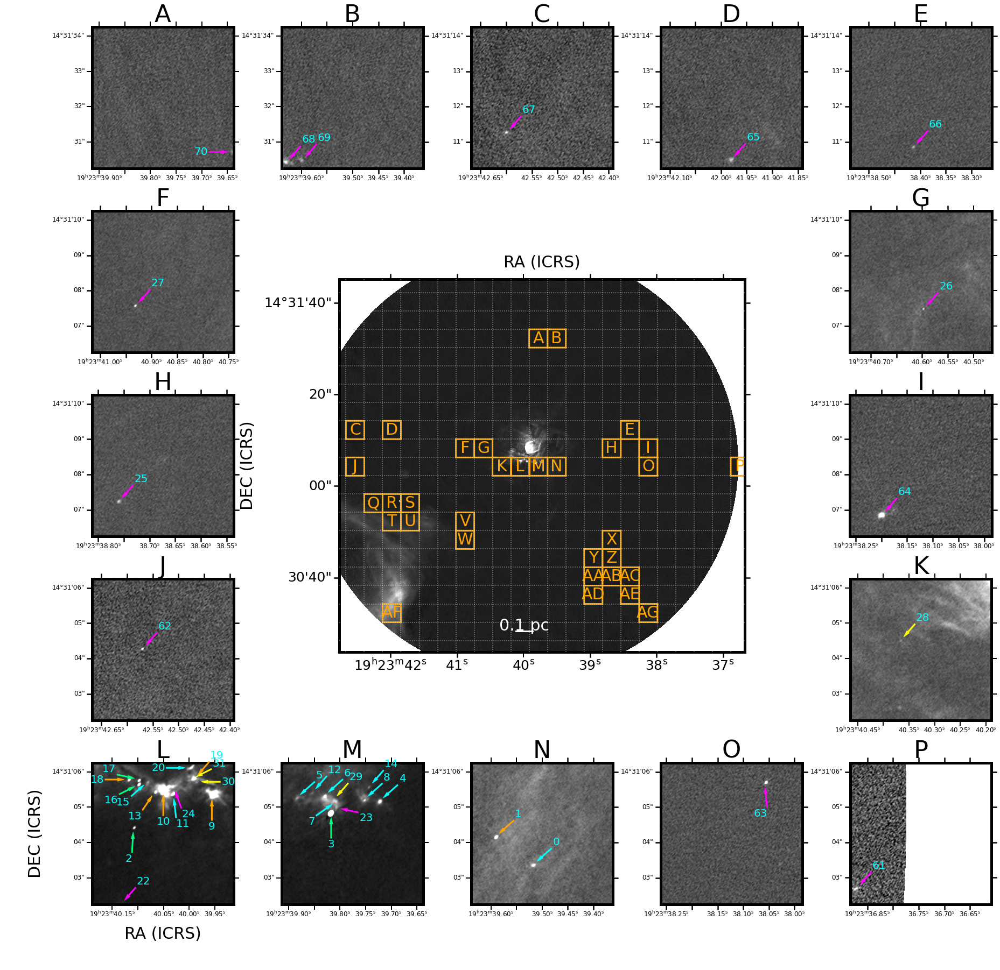

In [ ]:
from astropy.wcs.utils import proj_plane_pixel_scales
from astropy.visualization.wcsaxes import WCSAxes
import matplotlib.pyplot as plt
import numpy as np
from astropy import units as u
from regions import PixCoord
from regions import RectangleSkyRegion, RectanglePixelRegion
from matplotlib.gridspec import GridSpec


def plot_subregion2(fig, gs, image, xycoords_w51e, xycoords_w51n, catalog_w51e_yso, catalog_w51n_yso, wcs, wcs_other, 
reg1,  ax_xind, ax_yind, label, arrow_angle, arrow_length,scattersize=80,circlesize=20, color='cyan', facecolor='cyan', no_label=True, anno_font_color='w', isrelative_scaling=False, faintvmax=True,):
    import matplotlib.colors as colors
    reg1_pix = reg1.to_pixel(wcs)
    reg1_mask = reg1_pix.to_mask()
    #x y swtiched
    if ax_yind==0:
        ax = fig.add_subplot(gs[ax_xind, 0], projection=wcs)
    elif ax_yind==1: 
        ax = fig.add_subplot(gs[ax_xind, 1:3], projection=wcs)
    elif ax_yind==2: 
        ax = fig.add_subplot(gs[ax_xind, 3], projection=wcs)
    elif ax_yind==3:
        ax = fig.add_subplot(gs[ax_xind, 4:6], projection=wcs)
    elif ax_yind==4:
        ax = fig.add_subplot(gs[ax_xind, 6], projection=wcs)

    
    ax.set_xlim(reg1_mask.bbox.ixmin, reg1_mask.bbox.ixmax)
    ax.set_ylim(reg1_mask.bbox.iymin, reg1_mask.bbox.iymax)
    if isrelative_scaling:
        vmin = np.nanmin(reg1_mask.cutout(image))
        vmax = 1.5*np.nanmax(reg1_mask.cutout(image))
        #vmin = np.percentile(reg1_mask.cutout(image), 5)
        #vmax = np.percentile(reg1_mask.cutout(image), 95)
        ax.imshow(reg1_mask.cutout(image), origin='lower',cmap=plt.get_cmap('gray'),
            vmin=vmin,vmax=vmax, extent=reg1_mask.bbox.extent)
    else:
        vmin = -0.0001066949037273116
        if faintvmax:
            vmax = 0.0002290923849534617
        else:
            vmax = 0.001092545412989736
    #ax.imshow(reg1_mask.cutout(image), origin='lower',cmap=plt.get_cmap('gray'),
    #        norm=colors.PowerNorm(gamma=0.5, vmin=vmin,vmax=vmax), extent=reg1_mask.bbox.extent)
    ax.imshow(reg1_mask.cutout(image), origin='lower',cmap=plt.get_cmap('gray'),
             vmin=vmin,vmax=vmax, extent=reg1_mask.bbox.extent)
    xycoords_w51n_sky = wcs_other.wcs_pix2world(xycoords_w51n,0)
    plot_dendrogram(ax, catalog_w51e_yso, 'arrow', wcsNB=wcs,band='b6',size=circlesize,color=color, facecolor=facecolor, extent=reg1_mask.bbox.extent, arrow_angle=arrow_angle, arrow_length=arrow_length, anno_font_color=anno_font_color, xycoords_manual=xycoords_w51e)
    plot_dendrogram(ax, catalog_w51n_yso, 'cross', wcsNB=wcs,band='b6',size=scattersize,color='cyan', facecolor='cyan',  extent=reg1_mask.bbox.extent, xycoords_manual=xycoords_w51n_sky, issky=True)

    ax.set_title(label, fontsize=45)
    ax.coords[0].set_ticklabel(exclude_overlapping=True)
    ax.coords[1].set_ticklabel(exclude_overlapping=True)
    ax.coords[0].set_ticklabel(size=12)
    ax.coords[1].set_ticklabel(size=12)

    #ax.coords[0].set_ticklabel_visible(False)
    #ax.coords[1].set_ticklabel_visible(False)    
    if no_label:
        ax.coords[0].set_axislabel(' ')
        ax.coords[1].set_axislabel(' ')
    else:
        ax.coords[0].set_axislabel('RA (ICRS)', fontsize=30)
        ax.coords[1].set_axislabel('DEC (ICRS)', fontsize=30)
# Assuming `wcs_highres_w51n_b3` is your WCS object and `image_highres_w51n_b3` is your image data
fig = plt.figure(figsize=(30, 30))

gs = GridSpec(5,7,wspace=0.3, hspace=0.3, width_ratios=[1,0.3,0.7,1,0.7,0.3,1])
ax_main = fig.add_subplot(gs[1:-1, 2:-2], projection=wcs_highres_w51n_b3)

# Display the image
ax_main.imshow(image_highres_w51n_b3, origin='lower', cmap='gray', 
          vmin=-0.00010907209521789237, vmax=0.0008191315689840496)

# Add grid with 5 arcsecond intervals
pixel_scale = proj_plane_pixel_scales(wcs_highres_w51n_b3)[0]  # Pixel scale in degrees/pixel
arcsec_per_pixel = pixel_scale * 3600  # Convert to arcseconds/pixel
grid_interval_pixels = 4 / arcsec_per_pixel  # Convert 4 arcseconds to pixels

# Generate grid lines
image_height, image_width = image_highres_w51n_b3.shape
x_coords = np.arange(0, image_width, grid_interval_pixels)
y_coords = np.arange(0, image_height, grid_interval_pixels)

xcen = (x_coords[:-1] + x_coords[1:]) / 2
ycen = (y_coords[:-1] + y_coords[1:]) / 2

cenxy = np.vstack((xcen, ycen)).T
cenxy_sky = wcs_highres_w51n_b3.wcs_pix2world(cenxy,0)
regions_grid = []
for y_sky in cenxy_sky[::-1, 1]:
    for x_sky in cenxy_sky[:, 0]:
        # Create a rectangle region for each grid point
        # Note: Adjust the width and height as needed
        regions_grid.append(RectangleSkyRegion(center=SkyCoord(ra=x_sky, dec=y_sky, unit=(u.deg, u.deg)),
                                    width=4*u.arcsec, height=4*u.arcsec,
                                    ))

labels = [chr(65 + i) for i in range(26)]
labels += [chr(65 + i) + chr(65 + j) for i in range(26) for j in range(26)]

reg_selected = []
count=0
for i, reg in enumerate(regions_grid):
    if any(reg.contains(yso_skycoord_w51n, wcs_highres_w51n_b3)):
        reg_pix = reg.to_pixel(wcs_highres_w51n_b3)
        reg_pix.plot(ax=ax_main, color='orange', lw=3)
        reg_selected.append(reg)

        print(labels[count])
        print(reg_pix.bounding_box)
        print(np.where(reg.contains(yso_skycoord_w51n, wcs_highres_w51n_b3)))
        count=count+1


# add alphabet labels. Alphabetical order. once all the alpha is used then it start from AA

for i, reg in enumerate(reg_selected):
    pix_reg = reg.to_pixel(wcs_highres_w51n_b3)
    center = pix_reg.bounding_box.center
  
    ax_main.text(center[1], center[0], labels[i], color='orange', fontsize=30, ha='center', va='center')




# Plot grid lines
for x in x_coords:
    ax_main.axvline(x=x, color='white', linestyle='dotted', alpha=0.5)
for y in y_coords:
    ax_main.axhline(y=y, color='white', linestyle='dotted', alpha=0.5)

# Add labels
ax_main.set_xlabel('RA (ICRS)', fontsize=30)
ax_main.set_ylabel('DEC (ICRS)', fontsize=30)
ax_main.coords[0].set_axislabel_position('t')
ax_main.coords[0].set_ticklabel(fontsize=25)
ax_main.coords[1].set_ticklabel(fontsize=25)
ax_main.set_ylim(1350,13000)
ax_main.set_xlim(1500,14150)
add_scale_bar(ax_main, 7000, 2000,  0.1*u.pc,
                 
                  scale_highres_w51n_b3, 5.4 * u.kpc, size=30, pad=180,xoffset=0.1)


num_yso = len(catalog_w51n_yso)

arrow_angle = np.ones(num_yso)*45
arrow_length = 30 * np.ones(num_yso)
    
ax_yinds = [0,1,2,3,4,0,4,0,4,0,4,0,1,2,3,4]
ax_xinds = [0,0,0,0,0,1,1,2,2,3,3,4,4,4,4,4]
reg_ind = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]

arrow_angle[70]=180

arrow_angle[18]=180; arrow_angle[16]=-150 ; arrow_angle[15]=-140;  
arrow_angle[13] = -130; arrow_angle[11] = -90 ; arrow_angle[9]=-90 ; arrow_angle[11]= -70 ; arrow_angle[24]=-60 ; arrow_angle[30]=0
arrow_angle[2]=-100 ; arrow_angle[10] = -90 ;arrow_angle[20]=-180; arrow_angle[17]=160
arrow_angle[23] = -20
arrow_angle[3]=-90 ; 
arrow_angle[7]=-140
arrow_angle[31]= 30

arrow_angle[63]= -100

for i, reg in enumerate(reg_selected[:16]):
    if i==11:
        no_label = False
    else:
        no_label = True

    if i==12 or i==11:
        faintvmax = False
    else:
        faintvmax = True
    plot_subregion2(fig, gs, image_highres_w51n_b3, yso_xysource_pix_w51n, yso_xysource_pix_w51e,catalog_w51n_yso, catalog_w51e_yso, wcs_highres_w51n_b3, wcs_highres_w51e_b3, reg, 
     ax_xinds[i], ax_yinds[i], labels[i], arrow_angle, arrow_length, scattersize=80, color=si_w51n, facecolor=si_w51n, anno_font_color='cyan', no_label=no_label, faintvmax=faintvmax, )
    


# Save the plot
plt.savefig('ppo_map_w51n.png',bbox_inches='tight', pad_inches=0.0)
plt.show()

len(catalog), len(x_both) 71 71
arrow_text_xoffset [ 2.12132034e+01  2.12132034e+01 -5.20944533e+00  1.83697020e-15
  2.12132034e+01  2.12132034e+01  2.12132034e+01 -2.29813333e+01
  2.12132034e+01  1.83697020e-15  1.83697020e-15  1.02606043e+01
  2.12132034e+01 -1.92836283e+01  2.12132034e+01 -2.29813333e+01
 -2.59807621e+01 -2.81907786e+01 -3.00000000e+01  2.12132034e+01
 -3.00000000e+01  2.12132034e+01  2.12132034e+01  2.81907786e+01
  1.50000000e+01  2.12132034e+01  2.12132034e+01  2.12132034e+01
  2.12132034e+01  2.12132034e+01  3.00000000e+01  2.59807621e+01
  2.12132034e+01  2.12132034e+01  2.12132034e+01  2.12132034e+01
  2.12132034e+01  2.12132034e+01  2.12132034e+01  2.12132034e+01
  2.12132034e+01 -3.00000000e+01  2.12132034e+01 -3.00000000e+01
 -3.00000000e+01  1.83697020e-15 -3.00000000e+01  2.12132034e+01
  1.83697020e-15  2.12132034e+01  2.12132034e+01  2.12132034e+01
  2.12132034e+01  2.12132034e+01  2.12132034e+01 -1.92836283e+01
  2.12132034e+01 -3.00000000e+01  2.121

len(catalog), len(x_both) 71 71
arrow_text_xoffset [ 2.12132034e+01  2.12132034e+01 -5.20944533e+00  1.83697020e-15
  2.12132034e+01  2.12132034e+01  2.12132034e+01 -2.29813333e+01
  2.12132034e+01  1.83697020e-15  1.83697020e-15  1.02606043e+01
  2.12132034e+01 -1.92836283e+01  2.12132034e+01 -2.29813333e+01
 -2.59807621e+01 -2.81907786e+01 -3.00000000e+01  2.12132034e+01
 -3.00000000e+01  2.12132034e+01  2.12132034e+01  2.81907786e+01
  1.50000000e+01  2.12132034e+01  2.12132034e+01  2.12132034e+01
  2.12132034e+01  2.12132034e+01  3.00000000e+01  2.59807621e+01
  2.12132034e+01  2.12132034e+01  2.12132034e+01  2.12132034e+01
  2.12132034e+01  2.12132034e+01  2.12132034e+01  2.12132034e+01
  2.12132034e+01 -3.00000000e+01  2.12132034e+01 -3.00000000e+01
 -3.00000000e+01  1.83697020e-15 -3.00000000e+01  2.12132034e+01
  1.83697020e-15  2.12132034e+01  2.12132034e+01  2.12132034e+01
  2.12132034e+01  2.12132034e+01  2.12132034e+01 -1.92836283e+01
  2.12132034e+01 -3.00000000e+01  2.121

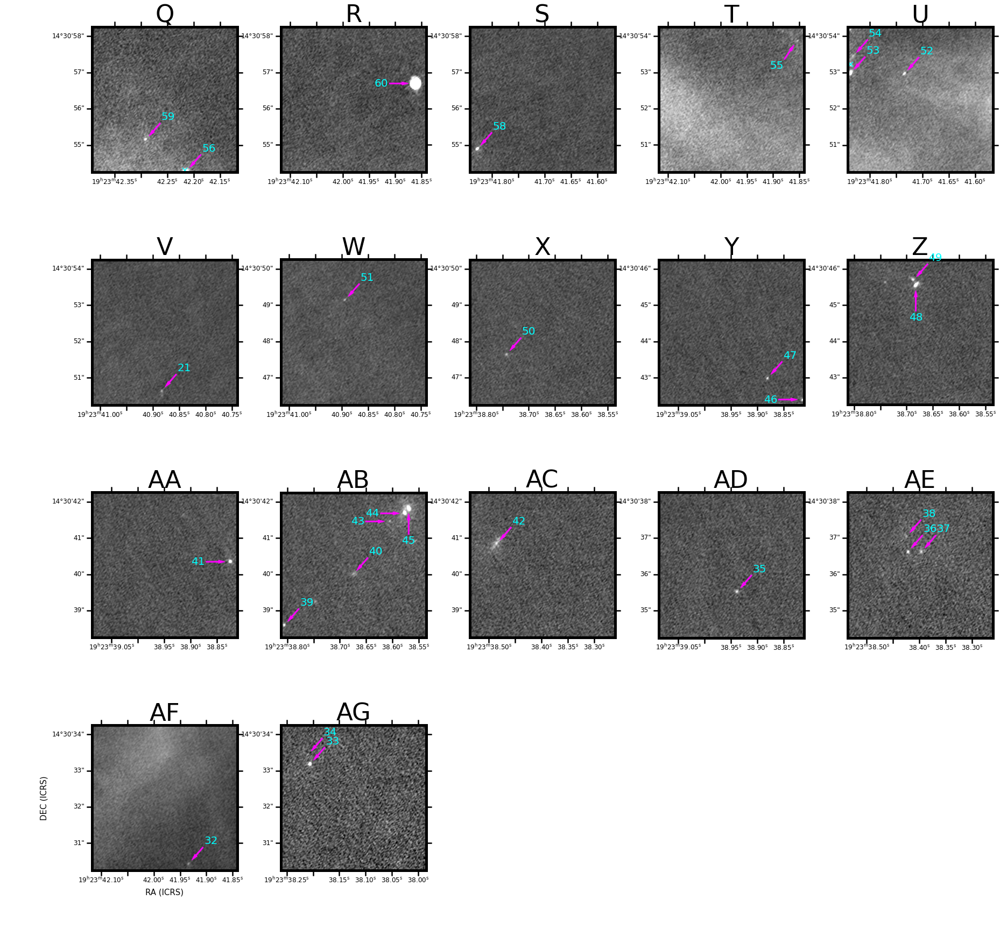

In [ ]:
fig = plt.figure(figsize=(30, 30))

gs = GridSpec(4,5,wspace=0.3, hspace=0.3)

ax_yinds = [0,1,2,3,4,0,1,2,3,4,0,1,2,3,4,0,1,2,3,4]
ax_xinds = [0,0,0,0,0,1,1,1,1,1,2,2,2,2,2,3,3,3,3,3]
reg_ind = np.arange(17)+16

arrow_angle[60]=180
arrow_angle[55] = -130
arrow_angle[57]=180
arrow_angle[46]=180
arrow_angle[48]=-90
arrow_angle[41]=180
arrow_angle[43]=180 ; arrow_angle[44]=180 ; arrow_angle[45]=-90

for i, reg in enumerate(reg_selected[16:]):
    if i==15:
        no_label = False
    else:
        no_label = True
    if i==15:
        faintvmax = False
    else:
        faintvmax = True
    plot_subregion(fig, gs, image_highres_w51n_b3, yso_xysource_pix_w51n, yso_xysource_pix_w51e, catalog_w51n_yso, catalog_w51e_yso,wcs_highres_w51n_b3, wcs_highres_w51e_b3, reg,
      ax_xinds[i], ax_yinds[i], labels[i+16], arrow_angle, arrow_length, scattersize=80, color=si_w51n, facecolor=si_w51n, anno_font_color='cyan', no_label=no_label, faintvmax=faintvmax)
plt.savefig('ppo_map_w51n2.png',bbox_inches='tight', pad_inches=0.0)
plt.show()

AttributeError: 'CoordinateHelper' object has no attribute 'get_ticklabel_coords'

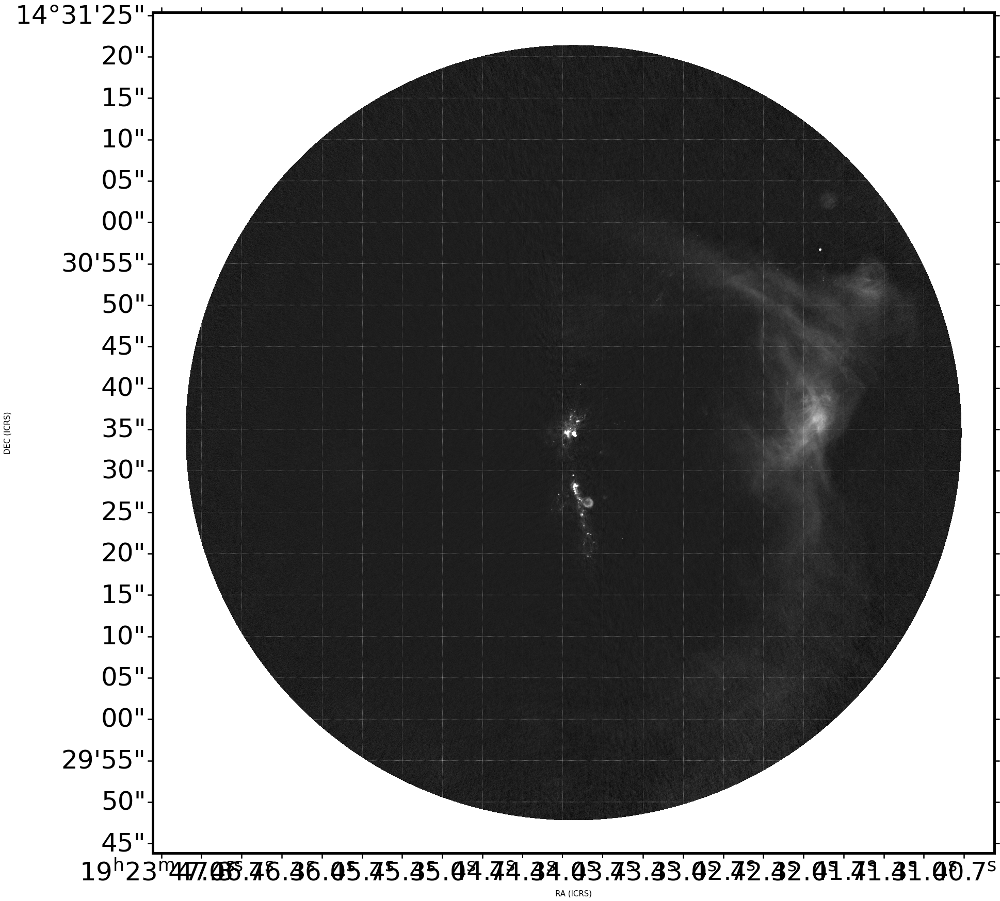

In [ ]:
from astropy.wcs.utils import proj_plane_pixel_scales
from astropy.visualization.wcsaxes import WCSAxes
import matplotlib.pyplot as plt
from regions import RectangleSkyRegion, RectanglePixelRegion

# Assuming `wcs_highres_w51e_b3` is your WCS object and `image_highres_w51e_b3` is your image data
fig = plt.figure(figsize=(30, 30))
ax = fig.add_subplot(111, projection=wcs_highres_w51e_b3)

# Display the image
ax.imshow(image_highres_w51e_b3, origin='lower', cmap='gray', 
          vmin=-0.00010907209521789237, vmax=0.0008191315689840496)

# Add grid with 5 arcsecond intervals
pixel_scale = proj_plane_pixel_scales(wcs_highres_w51e_b3)[0]  # Pixel scale in degrees/pixel
arcsec_per_pixel = pixel_scale * 3600  # Convert to arcseconds/pixel
grid_interval_pixels = 5 / arcsec_per_pixel  # Convert 5 arcseconds to pixels

# Set grid properties
ax.coords.grid(True, color='white', ls='dotted', alpha=0.5)
ax.coords[0].set_ticks(spacing=5 * u.arcsec)  # RA grid interval
ax.coords[1].set_ticks(spacing=5 * u.arcsec)  # DEC grid interval

# Add labels
ax.set_xlabel('RA (ICRS)', fontsize=15)
ax.set_ylabel('DEC (ICRS)', fontsize=15)

print(ax.coords[0])
grid_center_y = (ax.coords[1].get_ticklabel_coords() + ax.coords[1].get_ticklabel_coords()) / 2

yso_w51e_xsky_b6 = catalog_w51e_yso['b6_xsky'] ; yso_w51e_ysky_b6 = catalog_w51e_yso['b6_ysky']
yso_w51e_xsky_b3 = catalog_w51e_yso['b3_xsky'] ; yso_w51e_ysky_b3 = catalog_w51e_yso['b3_ysky']

yso_detect_w51e_b6 = np.where(yso_w51e_xsky_b6>0)[0]
yso_detect_w51e_b3 = np.where(yso_w51e_xsky_b3>0)[0]


yso_xsky_w51e = []
for i,x in enumerate(yso_w51e_xsky_b6):
    if x > 0:
        yso_xsky_w51e.append(x)
    else:
        yso_xsky_w51e.append(yso_w51e_xsky_b3[i])
yso_ysky_w51e = []
for i,x in enumerate(yso_w51e_ysky_b6):
    if x > 0:
        yso_ysky_w51e.append(x)
    else:
        yso_ysky_w51e.append(yso_w51e_ysky_b3[i])

regions_grid = [RectangleSkyRegion((grid_center_x[i], grid_center_y[i]), width=grid_interval_pixels, height=grid_interval_pixels) for i in range(len(grid_center_x))]

yso_skycoordinates = np.vstack((yso_xsky_w51e, yso_ysky_w51e)).T

reg_ind_yso = []
for i, reg in enumerate(regions_grid):
    if reg.contains(yso_skycoordinates, wcs_highres_w51e_b3):
        reg_ind_yso.append(i)
# Plot the grid
for i, reg in enumerate(regions_grid):
    if i in reg_ind_yso:
        ax.add_patch(reg.to_pixel(wcs_highres_w51e_b3).plot(ax=ax, color='cyan', lw=2))
    else:
        ax.add_patch(reg.to_pixel(wcs_highres_w51e_b3).plot(ax=ax, color='red', lw=2))


# Save the plot
plot_dendrogram(ax, catalog_w51e_yso, 'scatter', wcsNB=wcs_highres_w51e_b3,band='b3',size=80,color=si_w51e, facecolor=si_w51e)

plt.savefig('grid_with_5_arcsec_interval.png')
plt.show()

In [ ]:
stop

NameError: name 'stop' is not defined

In [ ]:
xzXxzxzxzx

1.944444444444e-06 deg
1.8518518518518518e-05 rad
545.6740906009087


NameError: name 'num_left' is not defined

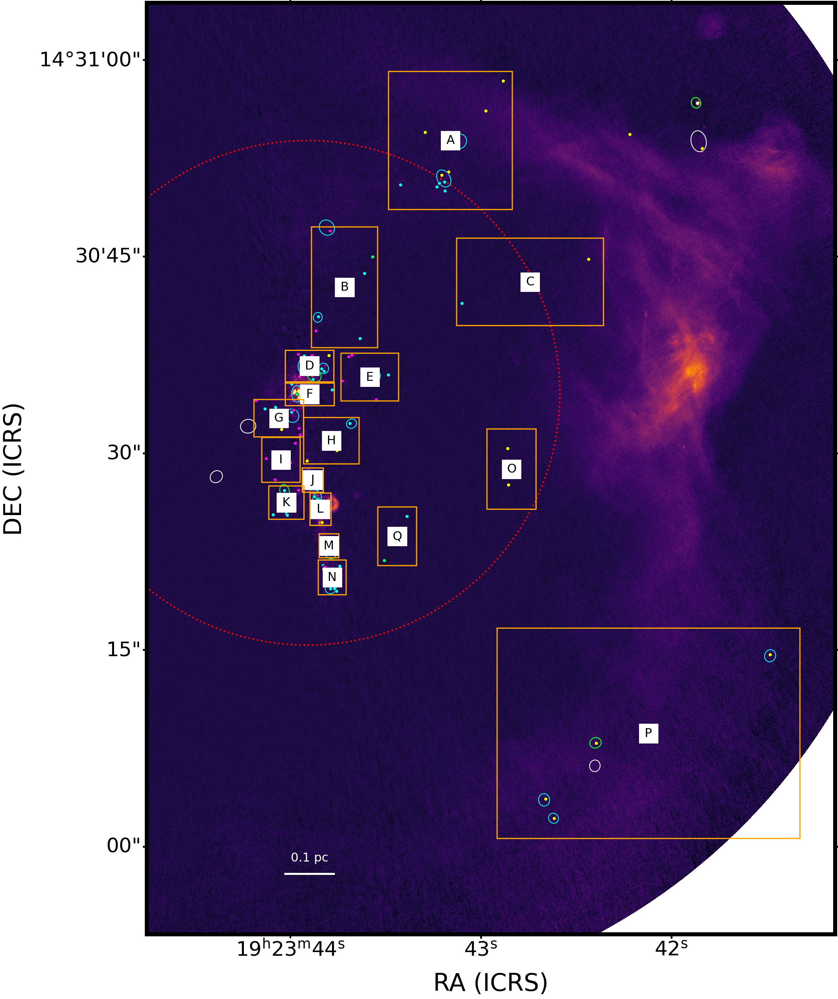

In [ ]:
from regions import Regions
def plot_cores(ax, skypos, afwhm, bfwhm, theta, hdrhr, beam_almaimf,color='cyan', lw=2, label=None,fontsize=40,ls='solid'):
    wcsNB = WCS(hdrhr,naxis=2)
    scalehr = wcsNB.proj_plane_pixel_scales()[0]
    xypos = wcsNB.wcs_world2pix(skypos,0)

    for i in range(len(xypos)):
        meanbeamsize = (beam_almaimf.major.value+beam_almaimf.minor.value)/4
        major = (afwhm[i]/3600+meanbeamsize)/scalehr.value
        minor = (bfwhm[i]/3600+meanbeamsize)/scalehr.value
        pa = 90+theta[i]
        ellipse = Ellipse(xypos[i],width=major,height=minor,facecolor='none',
                          angle=180-pa,edgecolor=color,lw=lw) 
        ax.add_patch(ellipse)
        if label is not None:
            if isinstance(label[i],u.Quantity):
                ax.text(xypos[i][0],xypos[i][1],'%3.2f'%label[i].value,color=color,fontsize=8,ls=ls) 
            else:
                ax.text(xypos[i][0],xypos[i][1],label[i],color=color,fontsize=fontsize,ls=ls)
def plot_regions(ax, regionfiledir, wcshr, labelon=True,lw=3):
    regions_read = Regions.read(regionfiledir, format='ds9')
    labels = [chr(65 + i) for i in range(len(regions_read))]
    for region, label in zip(regions_read, labels):
        pix_reg = region.to_pixel(wcshr)
        pix_reg.plot(ax=ax1, color='orange', lw=lw)
        
        if labelon:
            center = pix_reg.bounding_box.center
            white_square = Rectangle((center[1]-100, center[0]-100), 200, 200, color='white', lw=3)
            ax.add_patch(white_square)
            ax.text(center[1], center[0], label, color='k', fontsize=30, ha='center', va='center')

no_w51e_b6crit_b3fov = core_catdata_w51e_b6_b6crit_b3fov.no[multiplicity_w51e_b6crit_b3fov[1]]
no_w51n_b6crit_b3fov = core_catdata_w51n_b6_b6crit_b3fov.no[multiplicity_w51n_b6crit_b3fov[1]]

fig = plt.figure(figsize=(80,80))
ax1 = fig.add_axes([0.3, 0.3, 0.4, 0.4], projection=wcs_highres_w51e_b3)
ax1.imshow(image_highres_w51e_b3, origin='lower',cmap=plt.get_cmap('gray'),
           vmin=-0.00010907209521789237,vmax=0.0008191315689840496)
draw_field_of_view(ax1,image_highres_w51e_b6 , wcs_highres_w51e_b6, wcs_highres_w51e_b3 , color='r', lw=4, ls='dotted') 

#plot_cores(ax1, skypos_w51e_b6_b6crit_b3fov_prestellar, core_catdata_w51e_b6_b6crit_b3fov.afwhm[prestellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.bfwhm[prestellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.theta[prestellar_w51e_b6crit_b3fov], 
#           hdrhr_w51e_b3, beamb6_w51e_almaimf, color='cyan', lw=2, label=no_w51e_b6crit_b3fov[prestellar_w51e_b6crit_b3fov])
plot_cores(ax1, skypos_w51e_b6_b6crit_b3fov_prestellar, core_catdata_w51e_b6_b6crit_b3fov.afwhm[prestellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.bfwhm[prestellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.theta[prestellar_w51e_b6crit_b3fov], 
           hdrhr_w51e_b3, beamb6_w51e_almaimf, color='w', lw=2, ls='dashed')
skypos_w51e_b6_b6crit_b3fov_protostellar = np.vstack((core_catdata_w51e_b6_b6crit_b3fov.sky_ra[protostellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.sky_dec[protostellar_w51e_b6crit_b3fov])).T
plot_cores(ax1, skypos_w51e_b6_b6crit_b3fov_protostellar, core_catdata_w51e_b6_b6crit_b3fov.afwhm[protostellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.bfwhm[protostellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.theta[protostellar_w51e_b6crit_b3fov], 
           hdrhr_w51e_b3, beamb6_w51e_almaimf, color='cyan', lw=2, ls='dashed' )

skypos_w51e_b6_b6crit_b3fov_wff= np.vstack((core_catdata_w51e_b6_b6crit_b3fov_ff.sky_ra, core_catdata_w51e_b6_b6crit_b3fov_ff.sky_dec)).T
plot_cores(ax1, skypos_w51e_b6_b6crit_b3fov_wff, core_catdata_w51e_b6_b6crit_b3fov_ff.afwhm, core_catdata_w51e_b6_b6crit_b3fov_ff.bfwhm, core_catdata_w51e_b6_b6crit_b3fov_ff.theta, 
           hdrhr_w51e_b3, beamb6_w51e_almaimf, color='lime', lw=2, ls='dashed' )


plot_dendrogram(ax1, catalog_w51e_yso, 'scatter', wcsNB=wcs_highres_w51e_b3,band='b3',size=80,color=si_w51e, facecolor=si_w51e)
ax1.set_ylim(1350,11500)
ax1.set_xlim(5500,13000)
ax1.set_xlabel('RA (ICRS)')
ax1.set_ylabel('DEC (ICRS)')
#ax, xpos,ypos,scale, pixel_scale, dist,
add_scale_bar(ax1, 7000, 2000,  0.1*u.pc,
                 
                  scale_highres_w51e_b3, 5.4 * u.kpc, size=30, pad=180,xoffset=0.1)
colors=sns.color_palette("tab10")
plot_regions(ax1, '/orange/adamginsburg/w51/TaehwaYoo/regions/w51e_for_overview_plot.reg', wcs_highres_w51e_b3)

# Define fixed size for all insets
inset_width = 0.15  # Fixed width in normalized figure coordinates
inset_height = 0.15  # Fixed height in normalized figure coordinates

# Dynamically calculate positions for left, upper, right, lower, and corner insets
# Ensure spacing is sufficient to avoid overlaps
if num_left > 1:
    left_positions = [[0.05, 0.1 + (0.8 - inset_height) / (num_left - 1) * i, inset_width, inset_height] for i in range(num_left)]
else:
    left_positions = [[0.05, 0.5 - inset_height / 2, inset_width, inset_height]]

if num_upper > 1:
    upper_positions = [[0.3 + (0.4 - inset_width) / (num_upper - 1) * i, 0.85, inset_width, inset_height] for i in range(num_upper)]
else:
    upper_positions = [[0.5 - inset_width / 2, 0.85, inset_width, inset_height]]

if num_right > 1:
    right_positions = [[0.75, 0.1 + (0.8 - inset_height) / (num_right - 1) * i, inset_width, inset_height] for i in range(num_right)]
else:
    right_positions = [[0.75, 0.5 - inset_height / 2, inset_width, inset_height]]

if num_lower > 1:
    lower_positions = [[0.3 + (0.4 - inset_width) / (num_lower - 1) * i, 0.05, inset_width, inset_height] for i in range(num_lower)]
else:
    lower_positions = [[0.5 - inset_width / 2, 0.05, inset_width, inset_height]]

# Corner positions (fixed positions for the four corners)
corner_positions = [
    [0.05, 0.85, inset_width, inset_height],  # Top-left corner
    [0.75, 0.85, inset_width, inset_height],  # Top-right corner
    [0.05, 0.05, inset_width, inset_height],  # Bottom-left corner
    [0.75, 0.05, inset_width, inset_height],  # Bottom-right corner
]

# Combine all positions
inset_positions = corner_positions + left_positions + upper_positions + right_positions + lower_positions

# Add insets for each region
for region, pos in zip(regions_read, inset_positions):
    pix_reg = region.to_pixel(wcs_highres_w51e_b3)
    bbox = pix_reg.bounding_box  # Get bounding box in pixel coordinates

    # Create an inset axis
    inset_ax = fig.add_axes(pos, projection=wcs_highres_w51e_b3)

    # Create a cutout for the zoomed-in region
    cutout = Cutout2D(image_highres_w51e_b3, position=pix_reg.center.xy,
                      size=(bbox.iymax - bbox.iymin, bbox.ixmax - bbox.ixmin),
                      wcs=wcs_highres_w51e_b3)

    # Plot the zoomed-in image
    inset_ax.imshow(cutout.data, origin='lower', cmap='gray',
                    vmin=-0.00010907209521789237, vmax=0.0008191315689840496)
    
    inset_ax.tick_params(axis='both', labelsize=13)
    inset_ax.set_xlabel('RA (ICRS)', fontsize=13)
    inset_ax.set_ylabel('Dec (ICRS)', fontsize=13)

    del cutout
plt.savefig('ppo_map_si_w51e_mosaic.png')

In [ ]:
from matplotlib.patches import Rectangle
from regions import Regions
from matplotlib.colors import PowerNorm
scale_highres_w51e_b3 = wcs_highres_w51e_b3.proj_plane_pixel_scales()[0]
# Read the regions file
region_file = '/orange/adamginsburg/w51/TaehwaYoo/regions/w51e_for_overview_plot.reg'
regions_list = Regions.read(region_file, format='ds9')

# Create individual plots for each region
downarrow = [[
    
]]
for i, region in enumerate(regions_list):
    fig = plt.figure(figsize=(10, 10),)
    ax = fig.add_subplot(111,  projection=wcs_highres_w51e_b3)
    # Plot the full image
   
    
    # Convert region to pixel coordinates
    pix_reg = region.to_pixel(wcs_highres_w51e_b3)
    
    # Get the bounding box of the region
    bbox = pix_reg.bounding_box
    
    
    width = bbox.ixmax - bbox.ixmin
    height = bbox.iymax - bbox.iymin

    cutout = Cutout2D(image_highres_w51e_b3, position=pix_reg.center.xy,
                      size=(bbox.iymax - bbox.iymin, bbox.ixmax - bbox.ixmin),
                      wcs=wcs_highres_w51e_b3)
    ax.imshow(cutout.data, origin='lower', cmap='gray',
                norm=PowerNorm(
              vmin=-0.000010755678389947802, vmax=0.002051937666363374, gamma=0.5))
    # Add labels and save the plot
    ax.set_xlabel('RA (ICRS)',fontsize=15)
    ax.set_ylabel('DEC (ICRS)',fontsize=15)
    #add_scale_bar(ax, bbox.ixmin + 0.1*width, bbox.iymin + 0.1*height, 1000*u.au, scale_highres_w51e_b3,5.4*u.kpc,size=10,)

    ax.tick_params(axis='both', which='major', labelsize=15)

    plot_dendrogram(ax, catalog_w51e_yso, 'arrow', wcsNB=wcs_highres_w51e_b3, band='b3', size=20, lw=4, fill=False, bbox=[bbox.ixmin, bbox.iymin])

    del cutout

    plt.savefig(f'w51e_region_{i + 1}.png')
    plt.show()
    plt.close(fig)

NameError: name 'wcs_highres_w51e_b3' is not defined

In [ ]:
ss

NameError: name 'ss' is not defined

1.944444444444e-06 deg
8.978031131658073e-07 rad
26.4550264550325
1.944444444444e-06 deg
8.978031131658073e-07 rad
26.4550264550325
1.944444444444e-06 deg
8.978031131658073e-07 rad
26.4550264550325
1.944444444444e-06 deg
8.978031131658073e-07 rad
26.4550264550325
1.944444444444e-06 deg
8.978031131658073e-07 rad
26.4550264550325
1.944444444444e-06 deg
8.978031131658073e-07 rad
26.4550264550325
1.944444444444e-06 deg
8.978031131658073e-07 rad
26.4550264550325
1.944444444444e-06 deg
8.978031131658073e-07 rad
26.4550264550325
1.944444444444e-06 deg
8.978031131658073e-07 rad
26.4550264550325
1.944444444444e-06 deg
8.978031131658073e-07 rad
26.4550264550325
1.944444444444e-06 deg
8.978031131658073e-07 rad
26.4550264550325
1.944444444444e-06 deg
8.978031131658073e-07 rad
26.4550264550325
1.944444444444e-06 deg
8.978031131658073e-07 rad
26.4550264550325
1.944444444444e-06 deg
8.978031131658073e-07 rad
26.4550264550325
1.944444444444e-06 deg
8.978031131658073e-07 rad
26.4550264550325
1.94444444

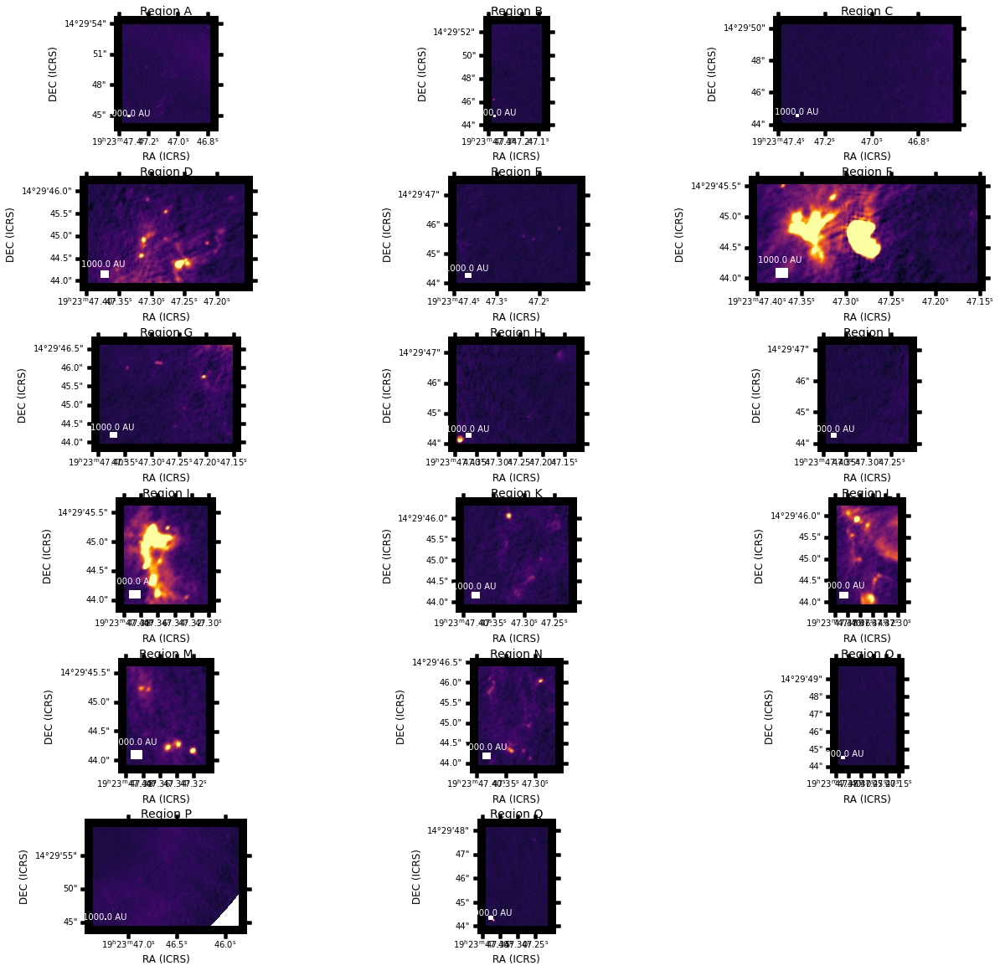

In [ ]:
from matplotlib.gridspec import GridSpec
from astropy.nddata.utils import Cutout2D

# Create a figure
fig = plt.figure(figsize=(20, 20))
regions_list = Regions.read('/orange/adamginsburg/w51/TaehwaYoo/regions/w51e_for_overview_plot.reg', format='ds9')

# Define the number of rows and columns for the grid
n_regions = len(regions_list)
n_cols = 3  # Number of columns
n_rows = (n_regions + n_cols - 1) // n_cols  # Calculate rows needed

# Define a GridSpec layout
grid = GridSpec(n_rows, n_cols, figure=fig, hspace=0.5, wspace=0.5)  # Adjust spacing

# Loop through each region and plot
for i, region in enumerate(regions_list):
    row, col = divmod(i, n_cols)  # Determine row and column index
    ax = fig.add_subplot(grid[row, col], projection=wcs_highres_w51e_b3)
    
    # Convert region to pixel coordinates
    pix_region = region.to_pixel(wcs_highres_w51e_b3)
    
    # Get the bounding box of the region
    bbox = pix_region.bounding_box
    
    # Create a Cutout2D object for the region
    cutout = Cutout2D(image_highres_w51e_b3, position=pix_region.center.xy, size=(bbox.iymax - bbox.iymin, bbox.ixmax - bbox.ixmin), wcs=wcs_highres_w51e_b3)
    
    # Plot the cutout image
    ax.imshow(cutout.data, origin='lower', cmap='gray',
              vmin=-0.00010907209521789237, vmax=0.0008191315689840496)
    
    # Update WCS for the cutout
    ax.set_xlim(0, cutout.data.shape[1])
    ax.set_ylim(0, cutout.data.shape[0])
    ax.set_xlabel('RA (ICRS)', fontsize=12)
    ax.set_ylabel('DEC (ICRS)', fontsize=12)
    
    # Add scale bar
    add_scale_bar(ax, 0.1 * cutout.data.shape[1], 
                  0.1 * cutout.data.shape[0], 
                  1000 * u.au, scale_highres_w51e_b3, 5.4 * u.kpc, size=10)
    
    ax.tick_params(axis='both', which='major', labelsize=10)
    ax.set_title('Region %s'%chr(65 + i), fontsize=14)

    del cutout

# Save the figure
plt.savefig('regions_overview.png')
plt.show()

In [ ]:
ssxx

NameError: name 'ss' is not defined

In [ ]:
from matplotlib.patches import Rectangle
from regions import Regions
scale_highres_w51e_b3 = wcs_highres_w51e_b3.proj_plane_pixel_scales()[0]
# Read the regions file
region_file = '/orange/adamginsburg/w51/TaehwaYoo/regions/w51e_for_overview_plot.reg'
regions_list = Regions.read(region_file, format='ds9')

# Create individual plots for each region
for i, region in enumerate(regions_list):
    fig, ax = plt.subplots(figsize=(10, 10), subplot_kw={'projection': wcs_highres_w51e_b3})
    
    # Plot the full image
    ax.imshow(image_highres_w51e_b3, origin='lower', cmap='gray',
              vmin=-0.00010907209521789237, vmax=0.0008191315689840496)
    
    # Convert region to pixel coordinates
    pix_region = region.to_pixel(wcs_highres_w51e_b3)
    
    # Get the bounding box of the region
    bbox = pix_region.bounding_box
    ax.set_xlim(bbox.ixmin, bbox.ixmax)
    ax.set_ylim(bbox.iymin, bbox.iymax)
    
    width = bbox.ixmax - bbox.ixmin
    height = bbox.iymax - bbox.iymin
    
    # Add labels and save the plot
    ax.set_xlabel('RA (ICRS)',fontsize=15)
    ax.set_ylabel('DEC (ICRS)',fontsize=15)
    add_scale_bar(ax, bbox.ixmin + 0.1*width, bbox.iymin + 0.1*height, 1000*u.au, scale_highres_w51e_b3,5.4*u.kpc,size=10,)

    ax.tick_params(axis='both', which='major', labelsize=15)

    plot_dendrogram(ax, catalog_w51e_yso, 'text',wcsNB=wcs_highres_w51e_b3, band='b3', size=20, lw=4, fill=False)

    plt.savefig(f'w51e_region_{i + 1}.png')
    plt.close(fig)
    

37.79999999999136 AU
545.6740906009087 6050 5500 15


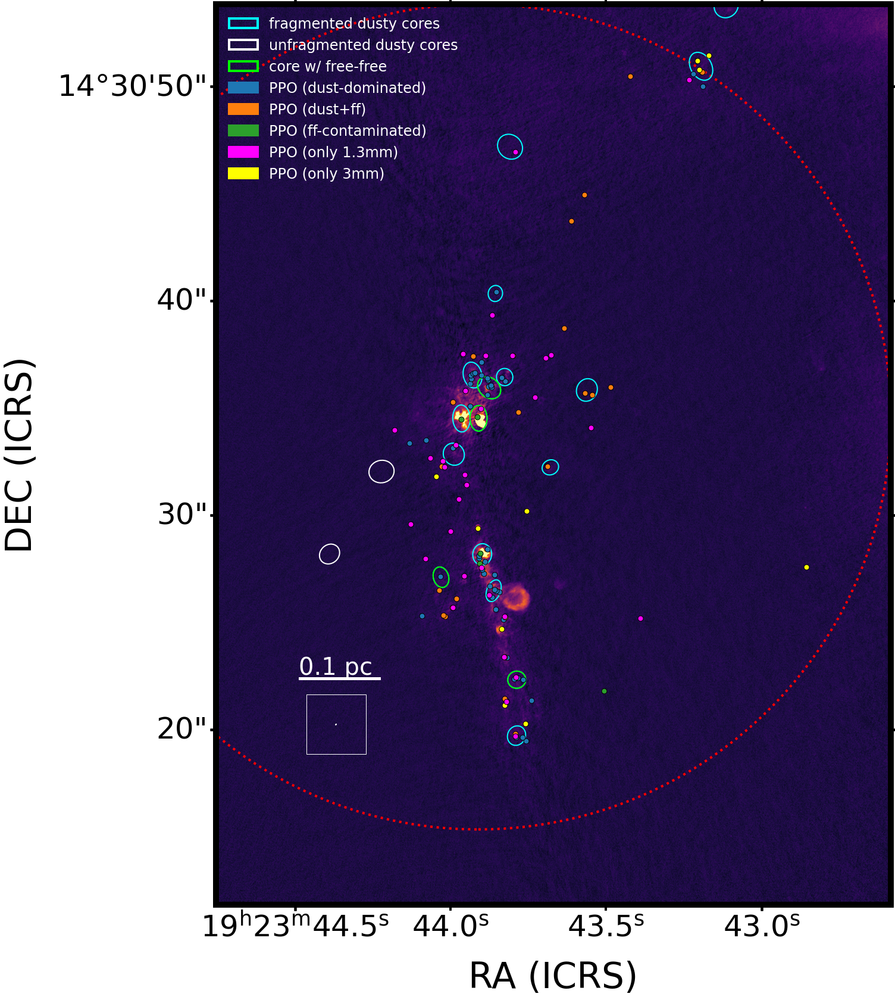

In [ ]:

fig = plt.figure(figsize=(30,30))
ax1 = fig.add_axes([0.3,0.3,0.7,0.7],projection=wcs_highres_w51e_b3)
ax1.imshow(image_highres_w51e_b3, origin='lower',cmap=plt.get_cmap('gray'),
           vmin=-0.00010907209521789237,vmax=0.0008191315689840496)
draw_field_of_view(ax1,image_highres_w51e_b6 , wcs_highres_w51e_b6, wcs_highres_w51e_b3 , color='r', lw=4, ls='dotted') 

plot_cores(ax1, skypos_w51e_b6_b6crit_b3fov_prestellar, core_catdata_w51e_b6_b6crit_b3fov.afwhm[prestellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.bfwhm[prestellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.theta[prestellar_w51e_b6crit_b3fov], 
           hdrhr_w51e_b3, beamb6_w51e_almaimf, color='w', lw=2, ls='dashed')
skypos_w51e_b6_b6crit_b3fov_protostellar = np.vstack((core_catdata_w51e_b6_b6crit_b3fov.sky_ra[protostellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.sky_dec[protostellar_w51e_b6crit_b3fov])).T
plot_cores(ax1, skypos_w51e_b6_b6crit_b3fov_protostellar, core_catdata_w51e_b6_b6crit_b3fov.afwhm[protostellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.bfwhm[protostellar_w51e_b6crit_b3fov], core_catdata_w51e_b6_b6crit_b3fov.theta[protostellar_w51e_b6crit_b3fov], 
           hdrhr_w51e_b3, beamb6_w51e_almaimf, color='cyan', lw=2, ls='dashed' )

skypos_w51e_b6_b6crit_b3fov_wff= np.vstack((core_catdata_w51e_b6_b6crit_b3fov_ff.sky_ra, core_catdata_w51e_b6_b6crit_b3fov_ff.sky_dec)).T
plot_cores(ax1, skypos_w51e_b6_b6crit_b3fov_wff, core_catdata_w51e_b6_b6crit_b3fov_ff.afwhm, core_catdata_w51e_b6_b6crit_b3fov_ff.bfwhm, core_catdata_w51e_b6_b6crit_b3fov_ff.theta, 
           hdrhr_w51e_b3, beamb6_w51e_almaimf, color='lime', lw=2, ls='dashed' )

plot_dendrogram_new(ax1, catalog_w51e_yso, wcsNB=wcs_highres_w51e_b3,band='b3',size=80,color=si_w51e, facecolor=si_w51e)
ax1.set_ylim(4000,10000)
ax1.set_xlim(5500,10000)
ax1.set_xlabel('RA (ICRS)')
ax1.set_ylabel('DEC (ICRS)')
colors=sns.color_palette("tab10")

circle = Circle((0,0),radius=0,  color='cyan', label='fragmented dusty cores',lw=4, fill=False)
ax1.add_patch(circle)
circle = Circle((0,0),radius=0, color='w', label='unfragmented dusty cores',lw=4, fill=False)
ax1.add_patch(circle)
circle = Circle((0,0),radius=0,  color='lime', label='core w/ free-free',lw=4, fill=False)
ax1.add_patch(circle)
circle = Circle((0,0),radius=0,  color=colors[0], label='PPO (dust-dominated)',lw=4,)
ax1.add_patch(circle)
circle = Circle((0,0),radius=0,  color=colors[1], label='PPO (dust+ff)',lw=4, )
ax1.add_patch(circle)
circle = Circle((0,0),radius=0,  color=colors[2], label='PPO (ff-contaminated)',lw=4, )
ax1.add_patch(circle)

circle = Circle((0,0),radius=0,  color='magenta', label='PPO (only 1.3mm)',lw=4, )
ax1.add_patch(circle)
circle = Circle((0,0),radius=0,  color='yellow', label='PPO (only 3mm)',lw=4, )
ax1.add_patch(circle)


ax1.legend(fontsize=24, loc='upper left',frameon=False, labelcolor='w')

add_beam(ax1,6300,5200, beam_highres_w51e_b3, scale_highres_w51e_b3,square=True,square_size=10000)
add_scale_bar(ax1, 6050, 5500, 0.1*u.pc, scale_highres_w51e_b3,5.4*u.kpc, xoffset=-0.4,height=15,pad=33)

plt.savefig('ppo_map_si_w51e_zoomed.png')

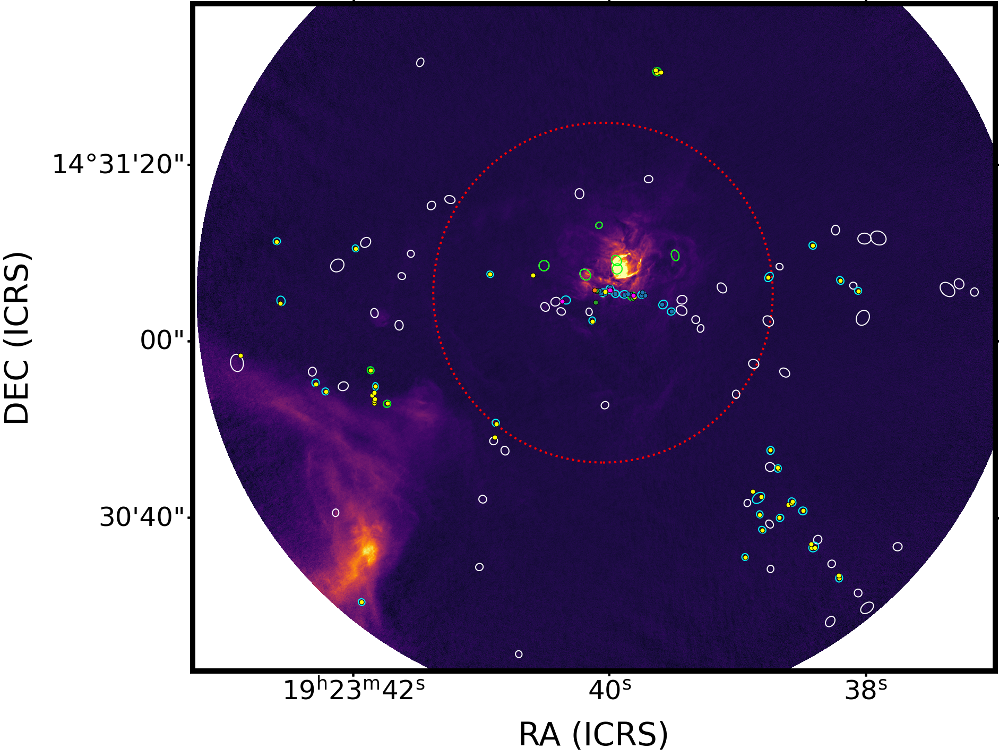

In [ ]:
fitsdata_highres_w51n_b3 = fits.open(Path.w51n_b3_tt0)
image_highres_w51n_b3 = fitsdata_highres_w51n_b3[0].data[0][0]
hdr_highres_w51n_b3 = fits.getheader(Path.w51n_b3_tt0)
wcs_highres_w51n_b3 = WCS(hdr_highres_w51n_b3,naxis=2)
beam_highres_w51n_b3 = Beam.from_fits_header(hdr_highres_w51n_b3)
scale_highres_w51n_b3 = wcs_highres_w51n_b3.proj_plane_pixel_scales()[0]

fitsdata_highres_w51n_b6 = fits.open(Path.w51n_b6_cont)
image_highres_w51n_b6 = fitsdata_highres_w51n_b6[0].data[0][0]
hdr_highres_w51n_b6 = fits.getheader(Path.w51n_b6_cont)
wcs_highres_w51n_b6 = WCS(hdr_highres_w51n_b6,naxis=2)
beam_highres_w51n_b6 = Beam.from_fits_header(hdr_highres_w51n_b6)
scale_highres_w51n_b6 = wcs_highres_w51n_b6.proj_plane_pixel_scales()[0]

skypos_w51n_b6_b6crit_b3fov_prestellar = np.vstack((core_catdata_w51n_b6_b6crit_b3fov.sky_ra[prestellar_w51n_b6crit_b3fov], core_catdata_w51n_b6_b6crit_b3fov.sky_dec[prestellar_w51n_b6crit_b3fov])).T



fig = plt.figure(figsize=(30,30))
ax1 = fig.add_axes([0.3,0.3,0.7,0.7],projection=wcs_highres_w51n_b3)
ax1.imshow(image_highres_w51n_b3, origin='lower',cmap=plt.get_cmap('gray'),
           vmin=-0.00010907209521789237,vmax=0.0008191315689840496)
draw_field_of_view(ax1,image_highres_w51n_b6 , wcs_highres_w51n_b6, wcs_highres_w51n_b3 , color='r', lw=4, ls='dotted') 

plot_cores(ax1, skypos_w51n_b6_b6crit_b3fov_prestellar, core_catdata_w51n_b6_b6crit_b3fov.afwhm[prestellar_w51n_b6crit_b3fov], core_catdata_w51n_b6_b6crit_b3fov.bfwhm[prestellar_w51n_b6crit_b3fov], core_catdata_w51n_b6_b6crit_b3fov.theta[prestellar_w51n_b6crit_b3fov], 
           hdrhr_w51n_b3, beamb6_w51n_almaimf, color='w', lw=2, ls='dashed')
skypos_w51n_b6_b6crit_b3fov_protostellar = np.vstack((core_catdata_w51n_b6_b6crit_b3fov.sky_ra[protostellar_w51n_b6crit_b3fov], core_catdata_w51n_b6_b6crit_b3fov.sky_dec[protostellar_w51n_b6crit_b3fov])).T
plot_cores(ax1, skypos_w51n_b6_b6crit_b3fov_protostellar, core_catdata_w51n_b6_b6crit_b3fov.afwhm[protostellar_w51n_b6crit_b3fov], core_catdata_w51n_b6_b6crit_b3fov.bfwhm[protostellar_w51n_b6crit_b3fov], core_catdata_w51n_b6_b6crit_b3fov.theta[protostellar_w51n_b6crit_b3fov], 
           hdrhr_w51n_b3, beamb6_w51n_almaimf, color='cyan', lw=2, ls='dashed' )

skypos_w51n_b6_b6crit_b3fov_wff= np.vstack((core_catdata_w51n_b6_b6crit_b3fov_ff.sky_ra, core_catdata_w51n_b6_b6crit_b3fov_ff.sky_dec)).T
plot_cores(ax1, skypos_w51n_b6_b6crit_b3fov_wff, core_catdata_w51n_b6_b6crit_b3fov_ff.afwhm, core_catdata_w51n_b6_b6crit_b3fov_ff.bfwhm, core_catdata_w51n_b6_b6crit_b3fov_ff.theta, 
           hdrhr_w51n_b3, beamb6_w51n_almaimf, color='lime', lw=2, ls='dashed' )

plot_dendrogram_new(ax1, catalog_w51n_yso, wcsNB=wcs_highres_w51n_b3,band='b3',size=80,color=si_w51n, facecolor=si_w51n)
#ax1.set_ylim(4000,10000)
#ax1.set_xlim(5500,10000)
ax1.set_xlabel('RA (ICRS)')
ax1.set_ylabel('DEC (ICRS)')
colors=sns.color_palette("tab10")

circle = Circle((0,0),radius=0,  color='cyan', label='fragmented dusty cores',lw=4, fill=False)
ax1.add_patch(circle)
circle = Circle((0,0),radius=0, color='w', label='unfragmented dusty cores',lw=4, fill=False)
ax1.add_patch(circle)
circle = Circle((0,0),radius=0,  color='lime', label='core w/ free-free',lw=4, fill=False)
ax1.add_patch(circle)
circle = Circle((0,0),radius=0,  color=colors[0], label='PPO (dust-dominated)',lw=4,)
ax1.add_patch(circle)
circle = Circle((0,0),radius=0,  color=colors[1], label='PPO (dust+ff)',lw=4, )
ax1.add_patch(circle)
circle = Circle((0,0),radius=0,  color=colors[2], label='PPO (ff-contaminated)',lw=4, )
ax1.add_patch(circle)

circle = Circle((0,0),radius=0,  color='magenta', label='PPO (only 1.3mm)',lw=4, )
ax1.add_patch(circle)
circle = Circle((0,0),radius=0,  color='yellow', label='PPO (only 3mm)',lw=4, )
ax1.add_patch(circle)


#ax1.legend(fontsize=24, loc='upper left',frameon=True, labelcolor='k')

#add_beam(ax1,6300,5200, beam_highres_w51n_b3, scale_highres_w51n_b3,square=True,square_size=10000)

#add_scale_bar(ax1, 6050, 5500, 0.1*u.pc, scale_highres_w51n_b3,5.4*u.kpc, xoffset=-0.4,height=15,pad=33)
ax1.set_ylim(1200,12000)
ax1.set_xlim(500,13500)
plt.savefig('ppo_map_si_w51n_largest1.png')


37.79999999999136 AU
545.6740906009087 7250 7000 25


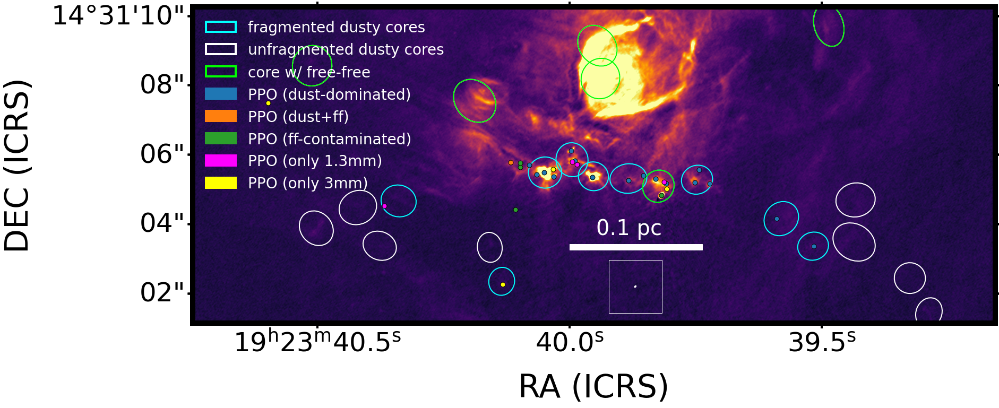

In [ ]:
fitsdata_highres_w51n_b3 = fits.open(Path.w51n_b3_tt0)
image_highres_w51n_b3 = fitsdata_highres_w51n_b3[0].data[0][0]
hdr_highres_w51n_b3 = fits.getheader(Path.w51n_b3_tt0)
wcs_highres_w51n_b3 = WCS(hdr_highres_w51n_b3,naxis=2)
beam_highres_w51n_b3 = Beam.from_fits_header(hdr_highres_w51n_b3)
scale_highres_w51n_b3 = wcs_highres_w51n_b3.proj_plane_pixel_scales()[0]

fitsdata_highres_w51n_b6 = fits.open(Path.w51n_b6_cont)
image_highres_w51n_b6 = fitsdata_highres_w51n_b6[0].data[0][0]
hdr_highres_w51n_b6 = fits.getheader(Path.w51n_b6_cont)
wcs_highres_w51n_b6 = WCS(hdr_highres_w51n_b6,naxis=2)
beam_highres_w51n_b6 = Beam.from_fits_header(hdr_highres_w51n_b6)
scale_highres_w51n_b6 = wcs_highres_w51n_b6.proj_plane_pixel_scales()[0]

skypos_w51n_b6_b6crit_b3fov_prestellar = np.vstack((core_catdata_w51n_b6_b6crit_b3fov.sky_ra[prestellar_w51n_b6crit_b3fov], core_catdata_w51n_b6_b6crit_b3fov.sky_dec[prestellar_w51n_b6crit_b3fov])).T



fig = plt.figure(figsize=(30,30))
ax1 = fig.add_axes([0.3,0.3,0.7,0.7],projection=wcs_highres_w51n_b3)
ax1.imshow(image_highres_w51n_b3, origin='lower',cmap=plt.get_cmap('gray'),
           vmin=-0.00010907209521789237,vmax=0.0008191315689840496)
draw_field_of_view(ax1,image_highres_w51n_b6 , wcs_highres_w51n_b6, wcs_highres_w51n_b3 , color='r', lw=4, ls='dotted') 

plot_cores(ax1, skypos_w51n_b6_b6crit_b3fov_prestellar, core_catdata_w51n_b6_b6crit_b3fov.afwhm[prestellar_w51n_b6crit_b3fov], core_catdata_w51n_b6_b6crit_b3fov.bfwhm[prestellar_w51n_b6crit_b3fov], core_catdata_w51n_b6_b6crit_b3fov.theta[prestellar_w51n_b6crit_b3fov], 
           hdrhr_w51n_b3, beamb6_w51n_almaimf, color='w', lw=2, ls='dashed')
skypos_w51n_b6_b6crit_b3fov_protostellar = np.vstack((core_catdata_w51n_b6_b6crit_b3fov.sky_ra[protostellar_w51n_b6crit_b3fov], core_catdata_w51n_b6_b6crit_b3fov.sky_dec[protostellar_w51n_b6crit_b3fov])).T
plot_cores(ax1, skypos_w51n_b6_b6crit_b3fov_protostellar, core_catdata_w51n_b6_b6crit_b3fov.afwhm[protostellar_w51n_b6crit_b3fov], core_catdata_w51n_b6_b6crit_b3fov.bfwhm[protostellar_w51n_b6crit_b3fov], core_catdata_w51n_b6_b6crit_b3fov.theta[protostellar_w51n_b6crit_b3fov], 
           hdrhr_w51n_b3, beamb6_w51n_almaimf, color='cyan', lw=2, ls='dashed' )

skypos_w51n_b6_b6crit_b3fov_wff= np.vstack((core_catdata_w51n_b6_b6crit_b3fov_ff.sky_ra, core_catdata_w51n_b6_b6crit_b3fov_ff.sky_dec)).T
plot_cores(ax1, skypos_w51n_b6_b6crit_b3fov_wff, core_catdata_w51n_b6_b6crit_b3fov_ff.afwhm, core_catdata_w51n_b6_b6crit_b3fov_ff.bfwhm, core_catdata_w51n_b6_b6crit_b3fov_ff.theta, 
           hdrhr_w51n_b3, beamb6_w51n_almaimf, color='lime', lw=2, ls='dashed' )

plot_dendrogram_new(ax1, catalog_w51n_yso, wcsNB=wcs_highres_w51n_b3,band='b3',size=80,color=si_w51n, facecolor=si_w51n)
#ax1.set_ylim(4000,10000)
#ax1.set_xlim(5500,10000)
ax1.set_xlabel('RA (ICRS)')
ax1.set_ylabel('DEC (ICRS)')
colors=sns.color_palette("tab10")

circle = Circle((0,0),radius=0,  color='cyan', label='fragmented dusty cores',lw=4, fill=False)
ax1.add_patch(circle)
circle = Circle((0,0),radius=0, color='w', label='unfragmented dusty cores',lw=4, fill=False)
ax1.add_patch(circle)
circle = Circle((0,0),radius=0,  color='lime', label='core w/ free-free',lw=4, fill=False)
ax1.add_patch(circle)
circle = Circle((0,0),radius=0,  color=colors[0], label='PPO (dust-dominated)',lw=4,)
ax1.add_patch(circle)
circle = Circle((0,0),radius=0,  color=colors[1], label='PPO (dust+ff)',lw=4, )
ax1.add_patch(circle)
circle = Circle((0,0),radius=0,  color=colors[2], label='PPO (ff-contaminated)',lw=4, )
ax1.add_patch(circle)

circle = Circle((0,0),radius=0,  color='magenta', label='PPO (only 1.3mm)',lw=4, )
ax1.add_patch(circle)
circle = Circle((0,0),radius=0,  color='yellow', label='PPO (only 3mm)',lw=4, )
ax1.add_patch(circle)


ax1.legend(fontsize=28, loc='upper left',frameon=False, labelcolor='w')

add_beam(ax1,7520,6850, beam_highres_w51n_b3, scale_highres_w51n_b3,square=True,square_size=10000)

add_scale_bar(ax1, 7250, 7000, 0.1*u.pc, scale_highres_w51n_b3,5.4*u.kpc, xoffset=-0.2,height=25,pad=63)
ax1.set_ylim(6700,8000)
ax1.set_xlim(5700,9000)
plt.savefig('ppo_map_si_w51n_zoomed.png')
